### Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
pd.options.display.max_columns = None
plt.rcParams['figure.figsize'] = [15, 8]

In [2]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier,StackingClassifier,VotingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split,GridSearchCV,KFold,cross_val_score
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.svm import SVC
from scipy import stats
from xgboost import XGBClassifier
from sklearn.feature_selection import RFE
from sklearn.metrics import accuracy_score,classification_report,confusion_matrix,roc_auc_score,roc_curve, precision_score, recall_score, f1_score, cohen_kappa_score

In [3]:
df = pd.read_csv('HCV-Egy-Data.csv')
df.head()

,Age,Gender,BMI,Fever,Nausea/Vomting,Headache,Diarrhea,Fatigue & generalized bone ache,Jaundice,Epigastric pain,WBC,RBC,HGB,Plat,AST 1,ALT 1,ALT4,ALT 12,ALT 24,ALT 36,ALT 48,ALT after 24 w,RNA Base,RNA 4,RNA 12,RNA EOT,RNA EF,Baseline histological Grading,Baselinehistological staging
0,56,1,35,2,1,1,1,2,2,2,7425,4248807.0,14,112132.0,99,84,52.0,109,81,5,5,5,655330,634536,288194,5,5,13,2
1,46,1,29,1,2,2,1,2,2,1,12101,4429425.0,10,129367.0,91,123,95.0,75,113,57,123,44,40620,538635,637056,336804,31085,4,2
2,57,1,33,2,2,2,2,1,1,1,4178,4621191.0,12,151522.0,113,49,95.0,107,116,5,5,5,571148,661346,5,735945,558829,4,4
3,49,2,33,1,2,1,2,1,2,1,6490,4794631.0,10,146457.0,43,64,109.0,80,88,48,77,33,1041941,449939,585688,744463,582301,10,3
4,59,1,32,1,1,2,1,2,2,2,3661,4606375.0,11,187684.0,99,104,67.0,48,120,94,90,30,660410,738756,3731527,338946,242861,11,1


### Description of the data

In [4]:
df_description = pd.read_csv('Discretization-Criteria.csv')
df_description

,Feature Names,Feature Values,Discretization (Items)
0,Age,32:61,"[0; 32], ]32; 37], ]37; 42],]42; 47], ]47; 52]..."
1,Gender,"Male,Female","[Male], [Female]"
2,BMI(Body Mass Index),22:35,"[0; 18:5[ [18:5; 25[, [25; 30[, [30; 35[, [35;..."
3,Fever,"Absent, Present","[Absent], [Present] -"
4,Nausea/Vomiting,"Absent, Present","[Absent], [Present] -"
5,Headache,"Absent, Present","[Absent], [Present] -"
6,Diarrhea,"Absent, Present","[Absent], [Present] -"
7,Fatigue,"Absent, Present","[Absent], [Present] -"
8,Bone ache,"Absent, Present","[Absent], [Present] -"
9,Jaundice,"Absent, Present","[Absent], [Present] -"


### Info of the dataset

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1385 entries, 0 to 1384
Data columns (total 29 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Age                               1385 non-null   int64  
 1   Gender                            1385 non-null   int64  
 2   BMI                               1385 non-null   int64  
 3   Fever                             1385 non-null   int64  
 4   Nausea/Vomting                    1385 non-null   int64  
 5   Headache                          1385 non-null   int64  
 6   Diarrhea                          1385 non-null   int64  
 7   Fatigue & generalized bone ache   1385 non-null   int64  
 8   Jaundice                          1385 non-null   int64  
 9   Epigastric pain                   1385 non-null   int64  
 10  WBC                               1385 non-null   int64  
 11  RBC                               1385 non-null   float64
 12  HGB   

In [6]:
df['Baselinehistological staging'].value_counts()

4    362
3    355
1    336
2    332
Name: Baselinehistological staging, dtype: int64

`Inference:`
    
    - We do not have any null values in the data.
    - Datatypes are misclassified.
    - There are 28 independent variables and 1 target variable `Baselinehistological staging`.

In [7]:
df.shape

(1385, 29)

- There are 1385 rows and 29 features in the dataset.

### Data Preprocessing

### Missing Values

In [8]:
df.isnull().sum()

Age                                 0
Gender                              0
BMI                                 0
Fever                               0
Nausea/Vomting                      0
Headache                            0
Diarrhea                            0
Fatigue & generalized bone ache     0
Jaundice                            0
Epigastric pain                     0
WBC                                 0
RBC                                 0
HGB                                 0
Plat                                0
AST 1                               0
ALT 1                               0
ALT4                                0
ALT 12                              0
ALT 24                              0
ALT 36                              0
ALT 48                              0
ALT after 24 w                      0
RNA Base                            0
RNA 4                               0
RNA 12                              0
RNA EOT                             0
RNA EF      

In [9]:
# No missing values in the dataset.

### Duplicates

In [10]:
df[df.duplicated()]

,Age,Gender,BMI,Fever,Nausea/Vomting,Headache,Diarrhea,Fatigue & generalized bone ache,Jaundice,Epigastric pain,WBC,RBC,HGB,Plat,AST 1,ALT 1,ALT4,ALT 12,ALT 24,ALT 36,ALT 48,ALT after 24 w,RNA Base,RNA 4,RNA 12,RNA EOT,RNA EF,Baseline histological Grading,Baselinehistological staging


In [11]:
# There are no duplicates in the dataset.

### Datatypes

In [12]:
df.dtypes

Age                                   int64
Gender                                int64
BMI                                   int64
Fever                                 int64
Nausea/Vomting                        int64
Headache                              int64
Diarrhea                              int64
Fatigue & generalized bone ache       int64
Jaundice                              int64
Epigastric pain                       int64
WBC                                   int64
RBC                                 float64
HGB                                   int64
Plat                                float64
AST 1                                 int64
ALT 1                                 int64
ALT4                                float64
ALT 12                                int64
ALT 24                                int64
ALT 36                                int64
ALT 48                                int64
ALT after 24 w                        int64
RNA Base                        

In [13]:
df.columns

Index(['Age ', 'Gender', 'BMI', 'Fever', 'Nausea/Vomting', 'Headache ',
       'Diarrhea ', 'Fatigue & generalized bone ache ', 'Jaundice ',
       'Epigastric pain ', 'WBC', 'RBC', 'HGB', 'Plat', 'AST 1', 'ALT 1',
       'ALT4', 'ALT 12', 'ALT 24', 'ALT 36', 'ALT 48', 'ALT after 24 w',
       'RNA Base', 'RNA 4', 'RNA 12', 'RNA EOT', 'RNA EF',
       'Baseline histological Grading', 'Baselinehistological staging'],
      dtype='object')

In [14]:
#Rename Columns
df.columns=['Age ', 'Gender', 'BMI', 'Fever', 'Nausea/Vomting','Headache ',
       'Diarrhea','Fatigue','Jaundice',
       'Epigastric_pain ', 'WBC','RBC','HGB', 'Plat','AST_1','ALT_1',
       'ALT_4', 'ALT_12','ALT_24','ALT_36','ALT_48','ALT_after_24w',
       'RNA_Base','RNA 4','RNA_12', 'RNA_EOT','RNA_EF',
       'Baseline_histological_Grading','Baselinehistological_staging']

In [15]:
# There are some spaces after the features. Better to remove them.

In [16]:
df.columns = df.columns.str.strip()

In [17]:
df.columns

Index(['Age', 'Gender', 'BMI', 'Fever', 'Nausea/Vomting', 'Headache',
       'Diarrhea', 'Fatigue', 'Jaundice', 'Epigastric_pain', 'WBC', 'RBC',
       'HGB', 'Plat', 'AST_1', 'ALT_1', 'ALT_4', 'ALT_12', 'ALT_24', 'ALT_36',
       'ALT_48', 'ALT_after_24w', 'RNA_Base', 'RNA 4', 'RNA_12', 'RNA_EOT',
       'RNA_EF', 'Baseline_histological_Grading',
       'Baselinehistological_staging'],
      dtype='object')

In [18]:
# There datatypes are misclassified. We have to change the below columns to category.

In [19]:
df_cat=df[['Gender','Fever','Nausea/Vomting','Headache','Fatigue','Jaundice','Diarrhea','Epigastric_pain',"Baselinehistological_staging"]]

In [20]:
df_cat

,Gender,Fever,Nausea/Vomting,Headache,Fatigue,Jaundice,Diarrhea,Epigastric_pain,Baselinehistological_staging
0,1,2,1,1,2,2,1,2,2
1,1,1,2,2,2,2,1,1,2
2,1,2,2,2,1,1,2,1,4
3,2,1,2,1,1,2,2,1,3
4,1,1,1,2,2,2,1,2,1
...,...,...,...,...,...,...,...,...,...
1380,1,1,2,2,1,1,2,1,4
1381,1,1,2,2,1,1,1,1,2
1382,1,2,2,1,1,2,1,1,2
1383,1,2,1,1,2,2,2,1,3


In [21]:
df_cat=df_cat.astype('category')

In [22]:
df_cat.head(2)

,Gender,Fever,Nausea/Vomting,Headache,Fatigue,Jaundice,Diarrhea,Epigastric_pain,Baselinehistological_staging
0,1,2,1,1,2,2,1,2,2
1,1,1,2,2,2,2,1,1,2


In [23]:
# Now lets check the info of the data.

In [24]:
df_cat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1385 entries, 0 to 1384
Data columns (total 9 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   Gender                        1385 non-null   category
 1   Fever                         1385 non-null   category
 2   Nausea/Vomting                1385 non-null   category
 3   Headache                      1385 non-null   category
 4   Fatigue                       1385 non-null   category
 5   Jaundice                      1385 non-null   category
 6   Diarrhea                      1385 non-null   category
 7   Epigastric_pain               1385 non-null   category
 8   Baselinehistological_staging  1385 non-null   category
dtypes: category(9)
memory usage: 13.5 KB


### Replacing the values

In [25]:
#Replacing the values to names e.g. 1:Male,2:Female 1:Absent,2:present 
df_cat['Gender'].replace([1,2],['Male','Female'],inplace=True)
df_cat['Gender']

0         Male
1         Male
2         Male
3       Female
4         Male
         ...  
1380      Male
1381      Male
1382      Male
1383      Male
1384    Female
Name: Gender, Length: 1385, dtype: category
Categories (2, object): ['Male', 'Female']

In [26]:
#check for the unique values for the other columns(Symptoms):
Symptoms_cols=df_cat[["Fever","Nausea/Vomting","Headache","Fatigue","Jaundice","Diarrhea",'Epigastric_pain']]

Symptoms_cols_values = df_cat[["Fever","Nausea/Vomting","Headache","Fatigue","Jaundice","Diarrhea",'Epigastric_pain']].values
unique_values =  np.unique(Symptoms_cols_values)

print(unique_values)

[1 2]


In [27]:
#Replacing values (1-2) to (Absent,Present) in Symptoms Features:

df_cat['Fever'].replace([1,2],['Absent','Present'],inplace=True)
df_cat['Nausea/Vomting'].replace([1,2],['Absent','Present'],inplace=True)
df_cat['Headache'].replace([1,2],['Absent','Present'],inplace=True)
df_cat['Fatigue'].replace([1,2],['Absent','Present'],inplace=True)
df_cat['Jaundice'].replace([1,2],['Absent','Present'],inplace=True)
df_cat['Diarrhea'].replace([1,2],['Absent','Present'],inplace=True)
df_cat['Epigastric_pain'].replace([1,2],['Absent','Present'],inplace=True)

In [28]:
# Target column
df_cat['Baselinehistological_staging'].unique()

[2, 4, 3, 1]
Categories (4, int64): [1, 2, 3, 4]

In [29]:
df_cat['Baselinehistological_staging'].replace([1,2,3,4],['Portal Fibrosis','Few Septa','Many Septa','Cirrhosis'],inplace=True)

In [30]:
df_cat.head()

,Gender,Fever,Nausea/Vomting,Headache,Fatigue,Jaundice,Diarrhea,Epigastric_pain,Baselinehistological_staging
0,Male,Present,Absent,Absent,Present,Present,Absent,Present,Few Septa
1,Male,Absent,Present,Present,Present,Present,Absent,Absent,Few Septa
2,Male,Present,Present,Present,Absent,Absent,Present,Absent,Cirrhosis
3,Female,Absent,Present,Absent,Absent,Present,Present,Absent,Many Septa
4,Male,Absent,Absent,Present,Present,Present,Absent,Present,Portal Fibrosis


In [31]:
# All the values have been replaced successfully.

### Distribution of the variables

In [32]:
cat_columns = list(df_cat.columns)  # Assuming df_cat is your DataFrame containing categorical columns
df_num = df.loc[:, ~df.columns.isin(cat_columns)]

In [33]:
df_num.head(2)

,Age,BMI,WBC,RBC,HGB,Plat,AST_1,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF,Baseline_histological_Grading
0,56,35,7425,4248807.0,14,112132.0,99,84,52.0,109,81,5,5,5,655330,634536,288194,5,5,13
1,46,29,12101,4429425.0,10,129367.0,91,123,95.0,75,113,57,123,44,40620,538635,637056,336804,31085,4


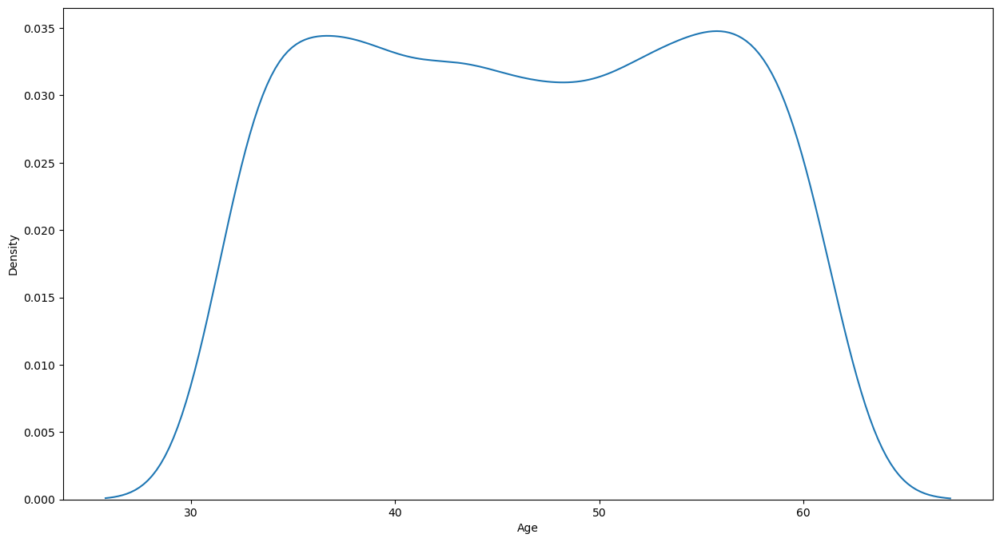

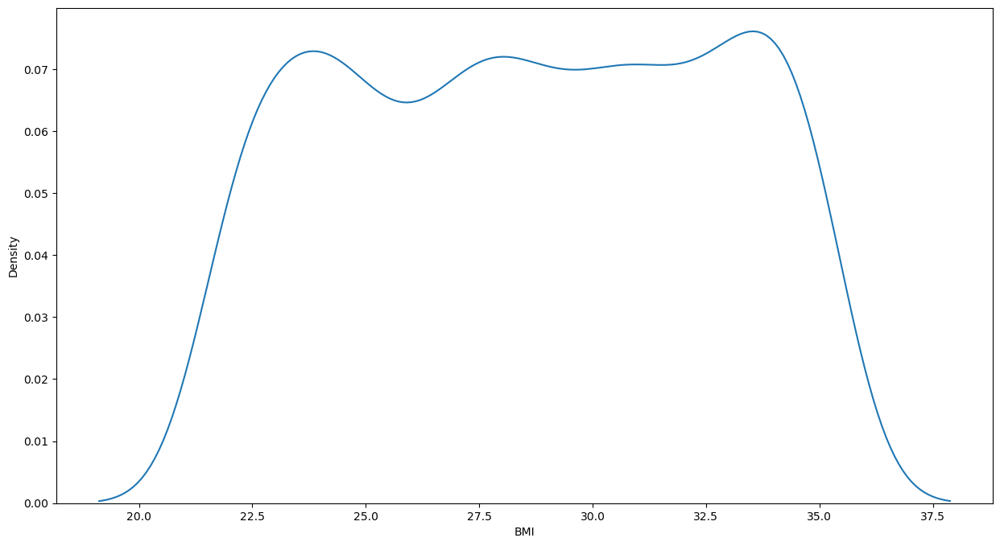

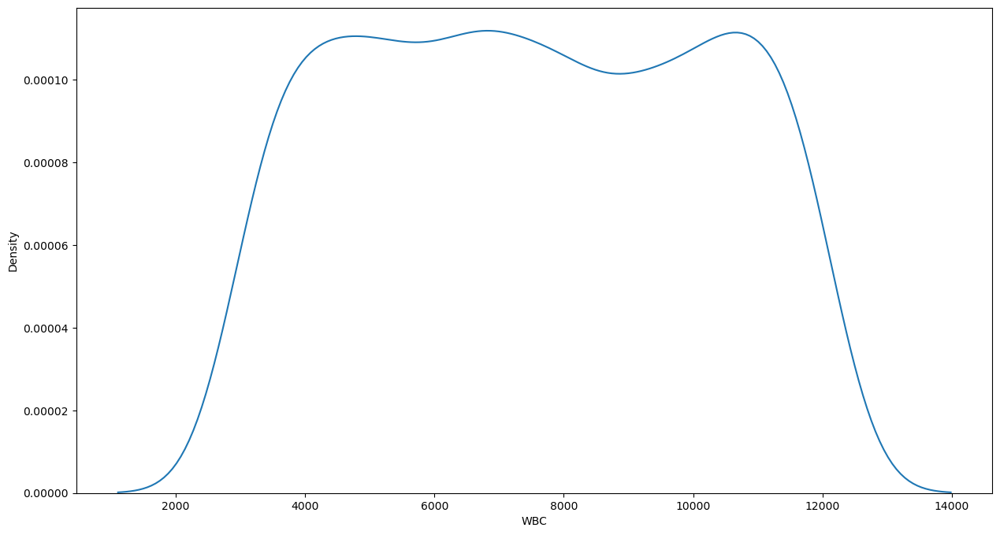

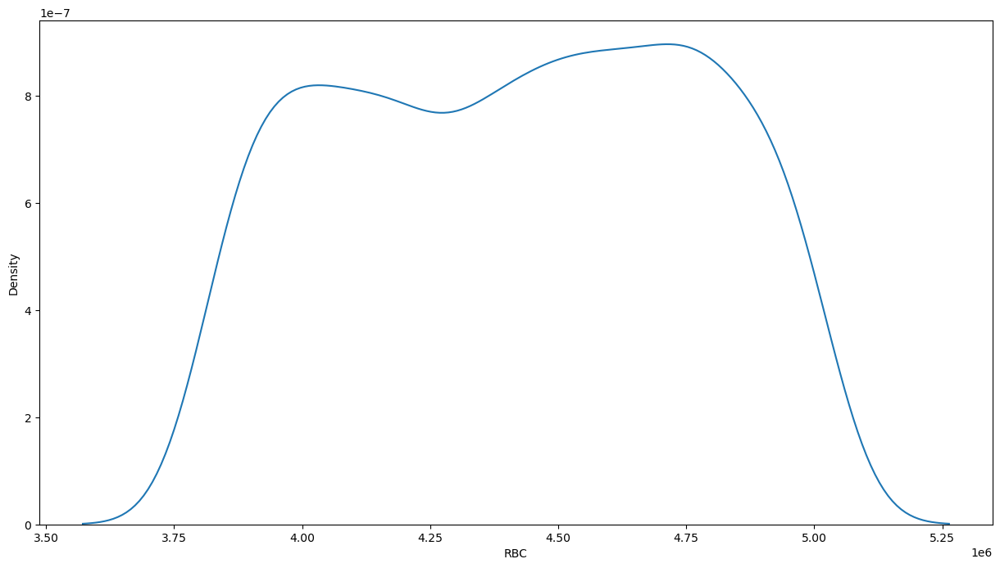

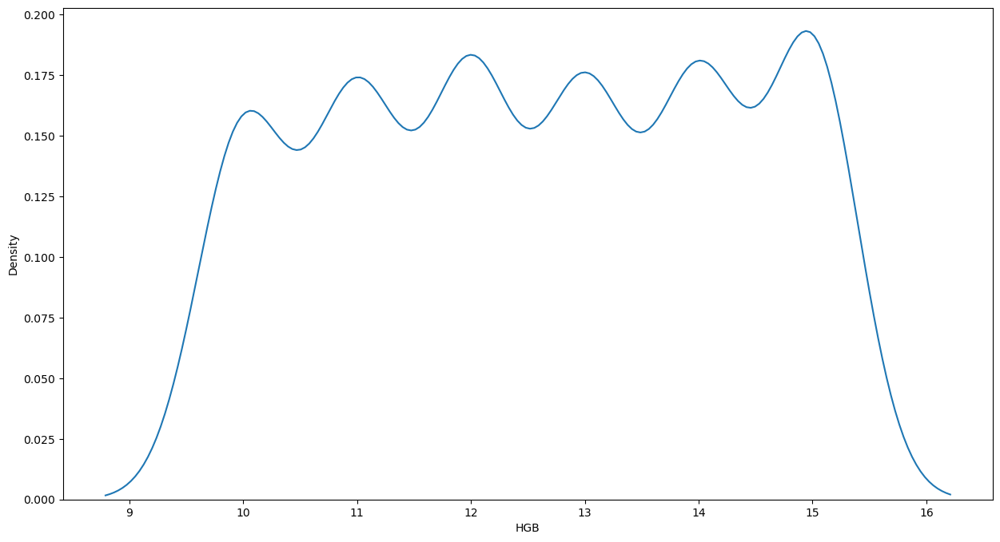

...

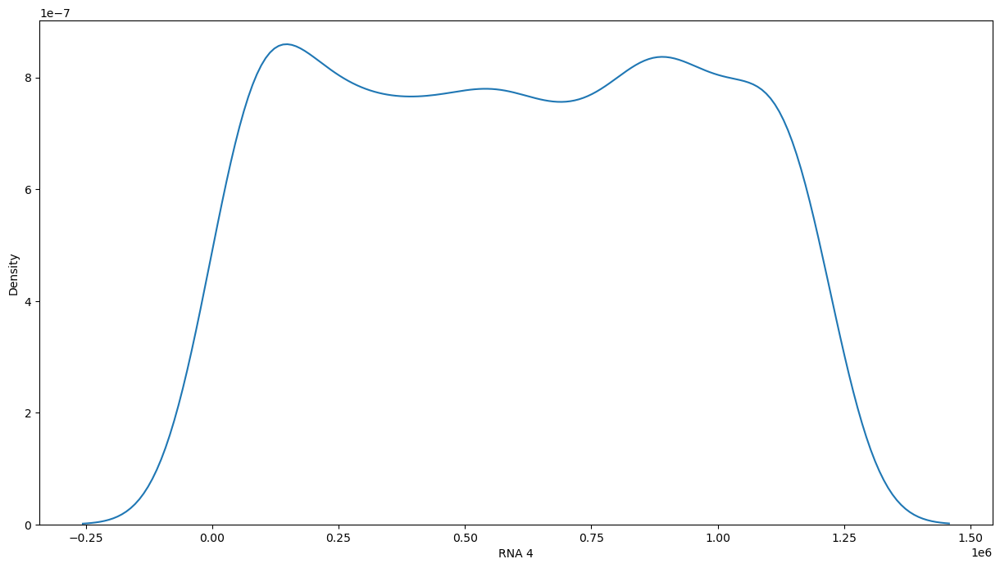

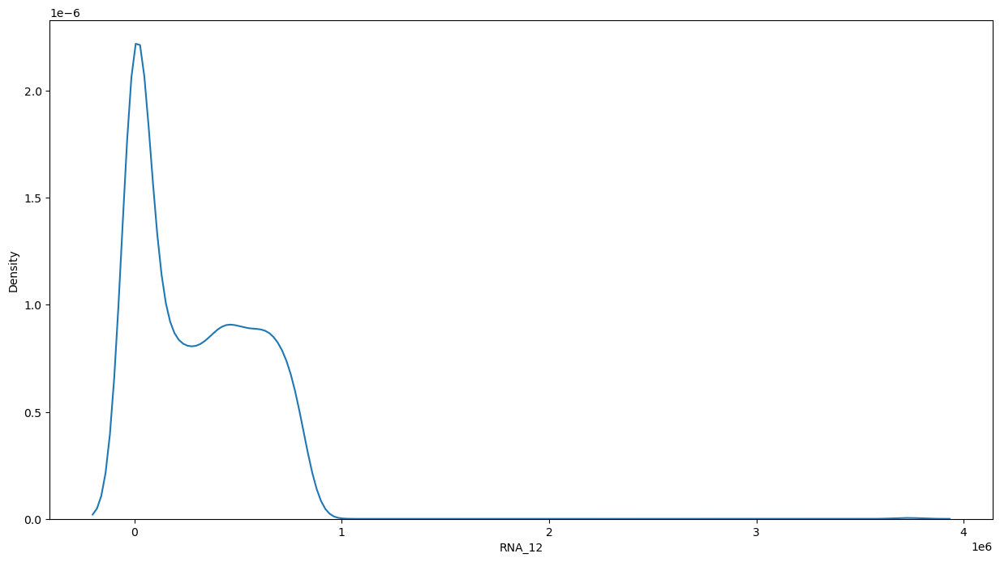

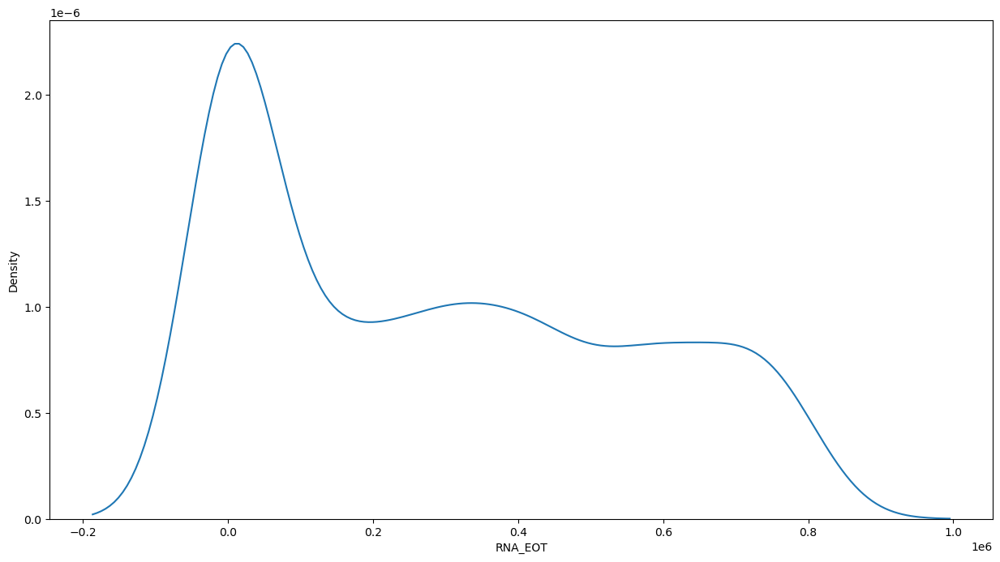

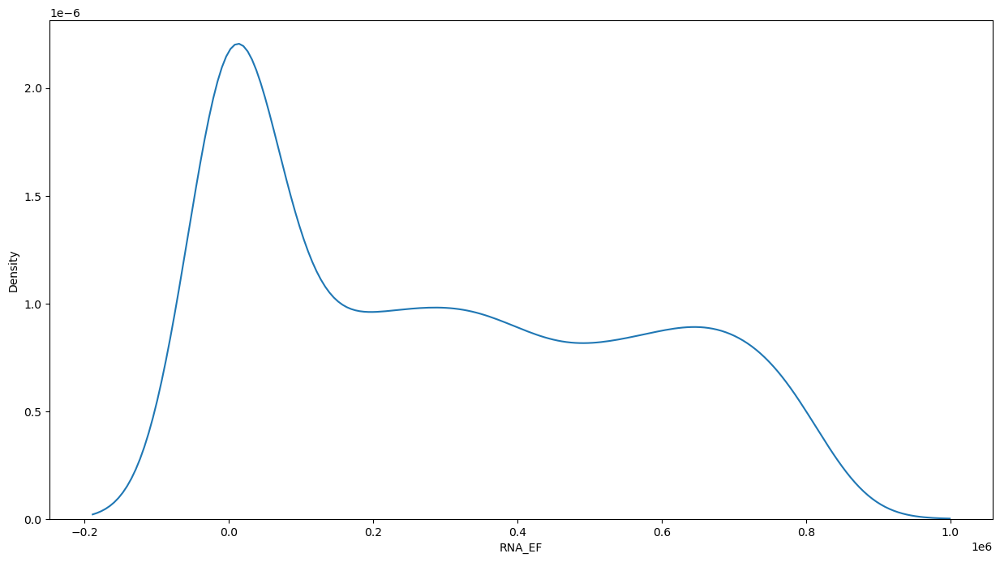

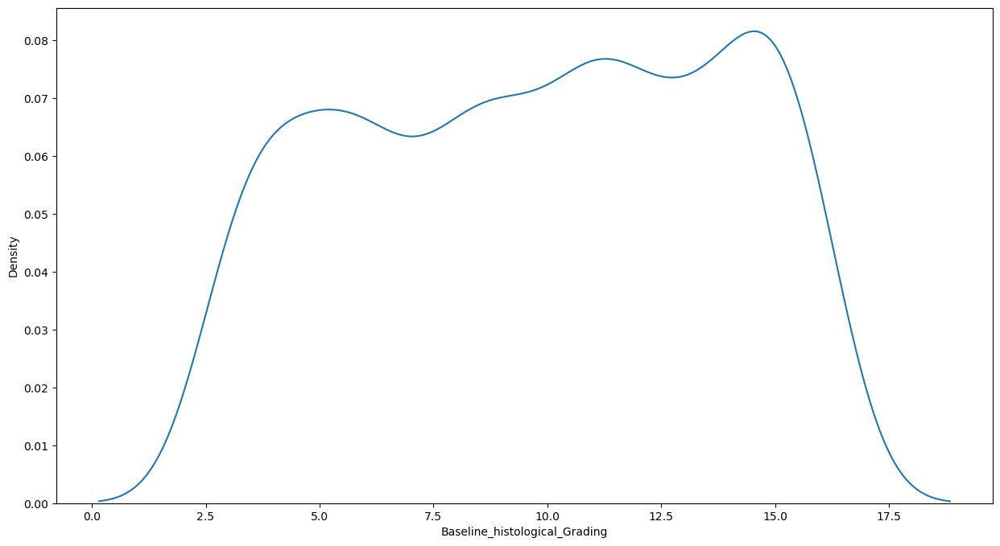

In [34]:
for i in df_num.columns:
    sns.kdeplot(df_num[i])
    plt.show()

In [35]:
# Most of the variables are having normal distribution.

### Skewness

In [36]:
df.skew()

Age                              0.006835
Gender                           0.041932
BMI                             -0.035573
Fever                           -0.062191
Nausea/Vomting                  -0.010119
Headache                         0.015902
Diarrhea                        -0.010119
Fatigue                          0.004337
Jaundice                        -0.004337
Epigastric_pain                 -0.015902
WBC                              0.016081
RBC                             -0.047663
HGB                             -0.046887
Plat                             0.032442
AST_1                            0.030132
ALT_1                            0.017926
ALT_4                            0.023289
ALT_12                          -0.011167
ALT_24                          -0.033095
ALT_36                          -0.041431
ALT_48                          -0.044457
ALT_after_24w                   -0.111222
RNA_Base                         0.018666
RNA 4                            0

In [37]:
# Only RNA_12 is right skewed, rest all the other columns are having a normal distribution.
# No need of transformations as well.

### Outliers

In [38]:
def outlier_function(df_num, col_name):
    
    first_quartile = np.percentile(np.array(df_num[col_name].tolist()), 25)
    third_quartile = np.percentile(np.array(df_num[col_name].tolist()), 75)
    IQR = third_quartile - first_quartile
                      
    upper_limit = third_quartile+(3*IQR)
    lower_limit = first_quartile-(3*IQR)
    outlier_count = 0
    
    for value in df_num[col_name].tolist():
        if (value < lower_limit) | (value > upper_limit):
            outlier_count +=1
    return lower_limit, upper_limit, outlier_count

In [39]:
for column in df_num.columns:
    if outlier_function(df_num, column)[2] > 0:
        print("There are {} outliers in {}".format(outlier_function(df_num, column)[2], column))

There are 1 outliers in RNA_12


In [40]:
# So only one outlier from the whole dataset.

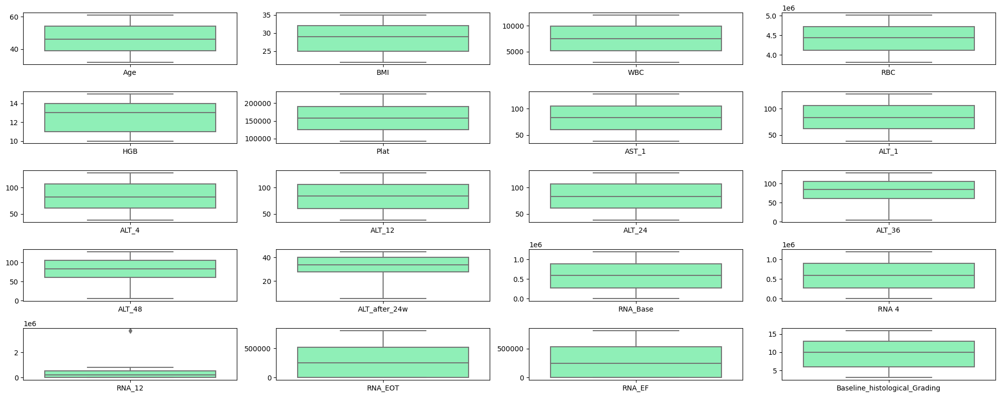

In [41]:
fig, ax = plt.subplots(nrows=5, ncols=4, figsize=(20, 8))

for variable, subplot in zip(df_num.columns, ax.flatten()):
    sns.boxplot(df_num[variable], ax=subplot, palette='rainbow_r', whis=3)
    subplot.set_xticklabels([variable])  # Set the x-axis labels for each subplot

plt.tight_layout()
plt.show()

In [42]:
# Hardly any outlers.

### Correlation

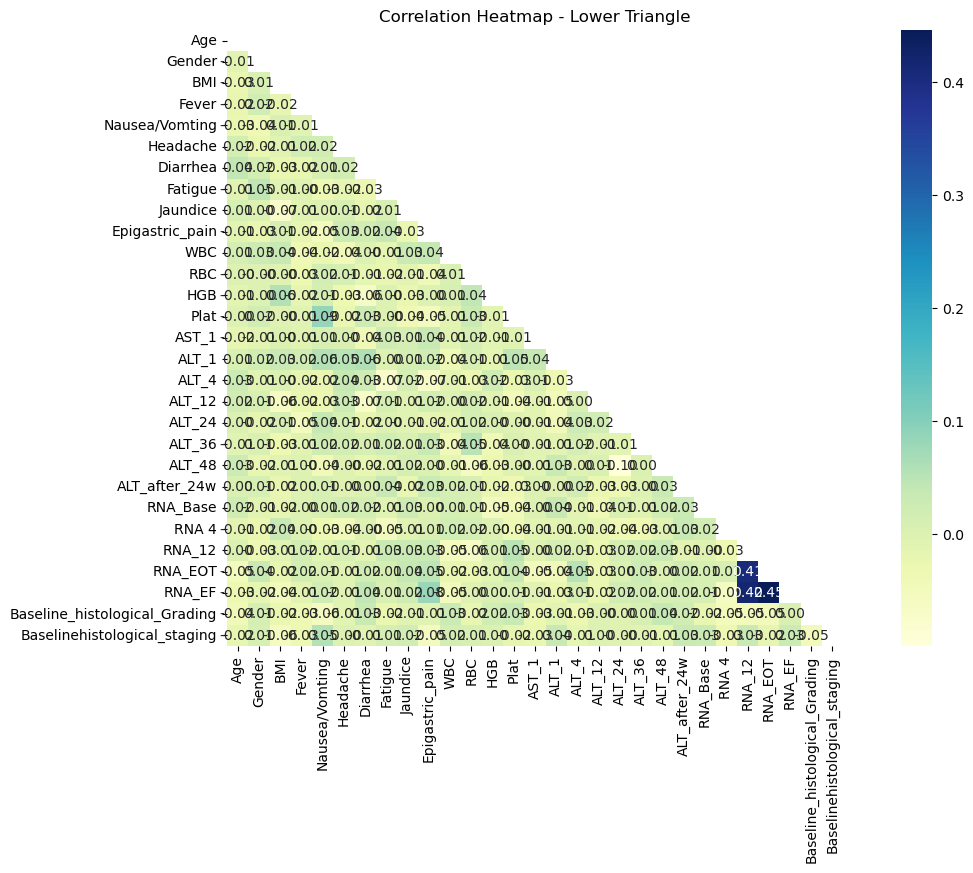

In [43]:
corr_matrix = df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

sns.heatmap(corr_matrix, mask=mask, annot=True, cmap="YlGnBu", fmt=".2f", square=True)
plt.title("Correlation Heatmap - Lower Triangle")
plt.show()

`Inference:`

- From the image, it seems that most variables have very low correlation with each other, as indicated by the values close to zero and the light coloration. This lack of strong correlation suggests that there may not be any single pair of variables that strongly predict one another.

- There are a few exceptions with moderate correlations. For example, at the end of the columns, you can see a correlation of 0.4 between RNA_EF and Baselinehistological_Grading, suggesting a moderate positive relationship.

In [44]:
# We also do have much correlation in the data.
# No multicollinearity.

### Analyzing the target variable

In [45]:
df.Baselinehistological_staging.value_counts()

4    362
3    355
1    336
2    332
Name: Baselinehistological_staging, dtype: int64

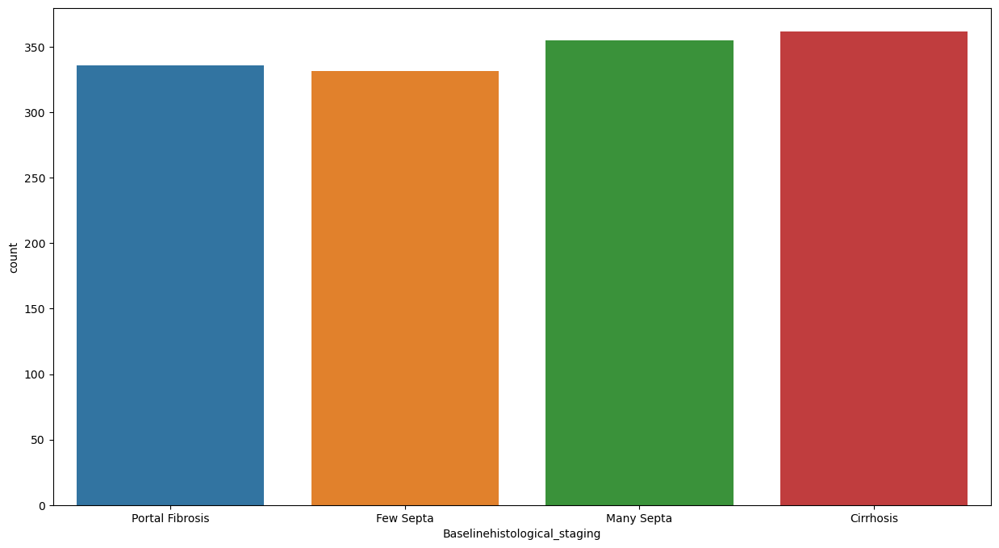

In [46]:
sns.countplot(data = df_cat, x = 'Baselinehistological_staging')
plt.show()

In [47]:
# Data Classes are also balanced.
# No imbalance in the dataset.

`Inference:`
    
- As of now, the dataset is looking very good.
- There are no missing values in the dataset.
- No duplicate values.
- Distribution of the variables is normal.
- No outliers.
- No imbalance in the dataset.
- No multicollinearity.
- This means the data is looking good. 
- We can build some exceptional ML models on this dataset.

#### Plan of action:
    
- Perform EDA, check if we have some relation between the variables, like understanding whether males are more attcked by HCV or females, or relation between hostological grading and hostological staging etc..
- Feature Engineering
- Statistical analysis to understand which variables contribute more to the performance of the models.
- Model Building
- Building a scorecard to select the best model on the traditional features.
- Performing Hyper parameter tuning.
- Selecting the best features (RF best features, RFE model, sfs model etc...)
- Buidling a scorecard on the best parameters from tuning.
- Buidling a scorecard on the best features.
- Model Validation and Evaluation.
- Finalizing the best model.
- Also, if we get a chnace to build the CNN model as well, we will try to do that. But the dataset is too small, but for CNN models, the datasets should be complex enough to get the better results.

### EDA (Exploratory Data Analysis)

### Analyzing all the categorical variables across the target variable

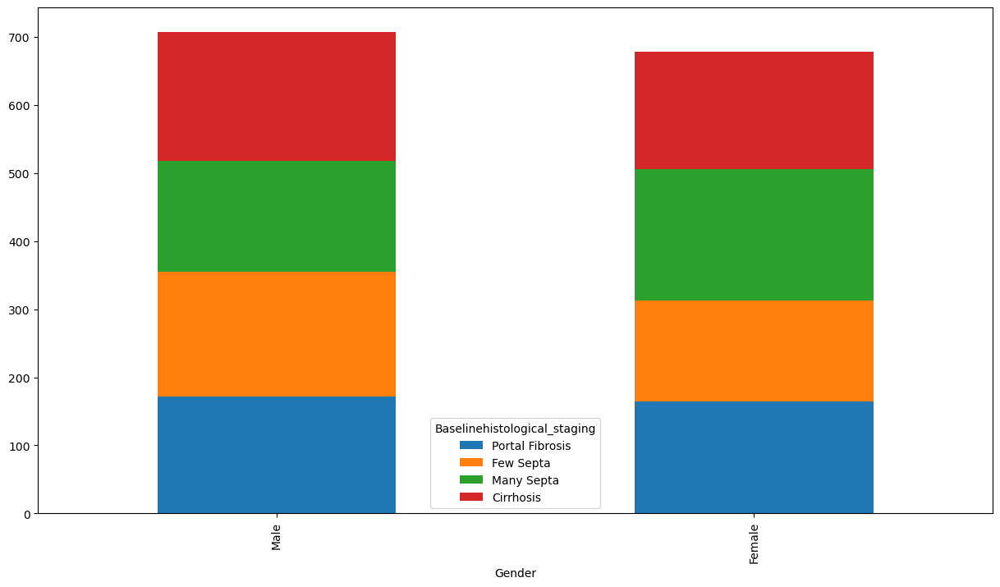

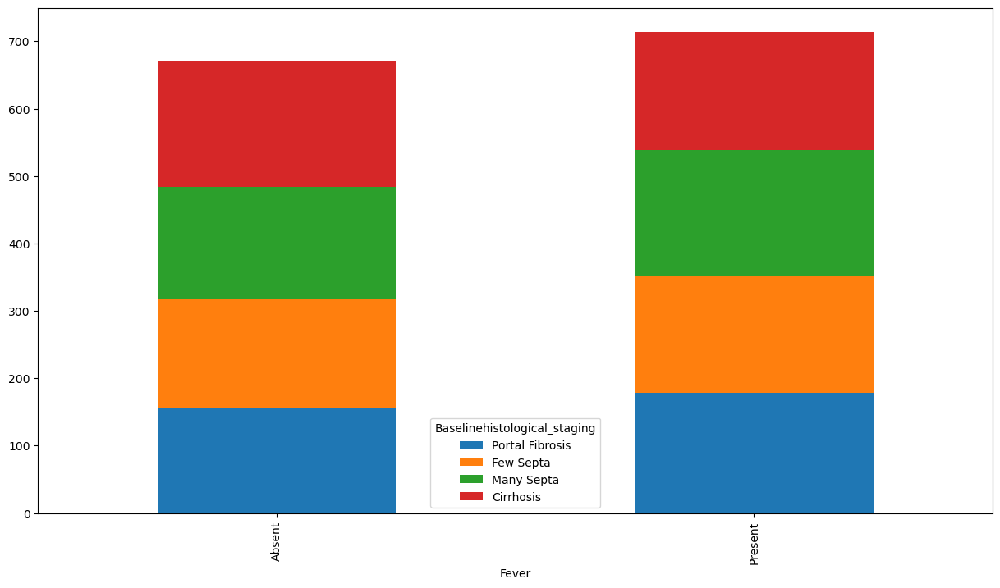

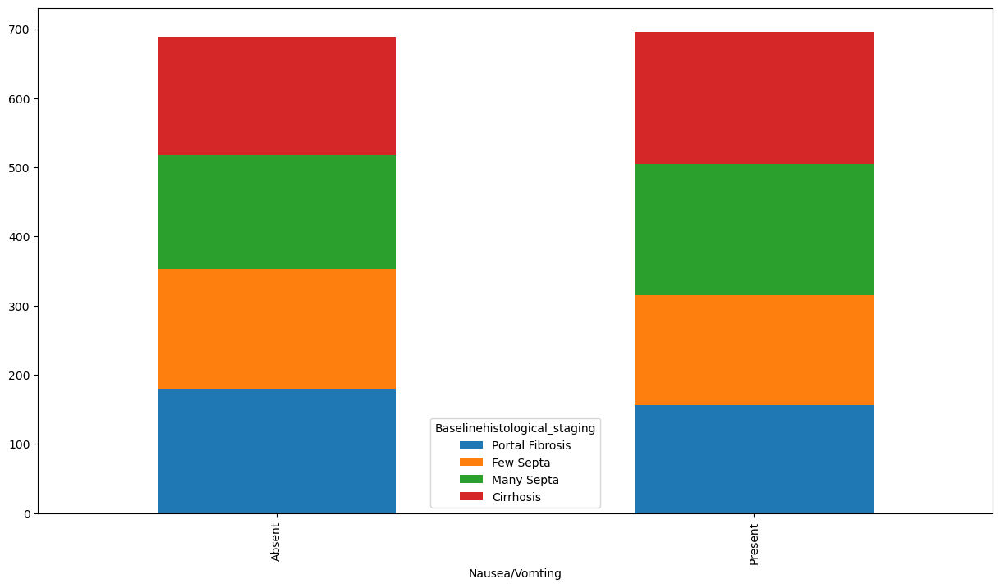

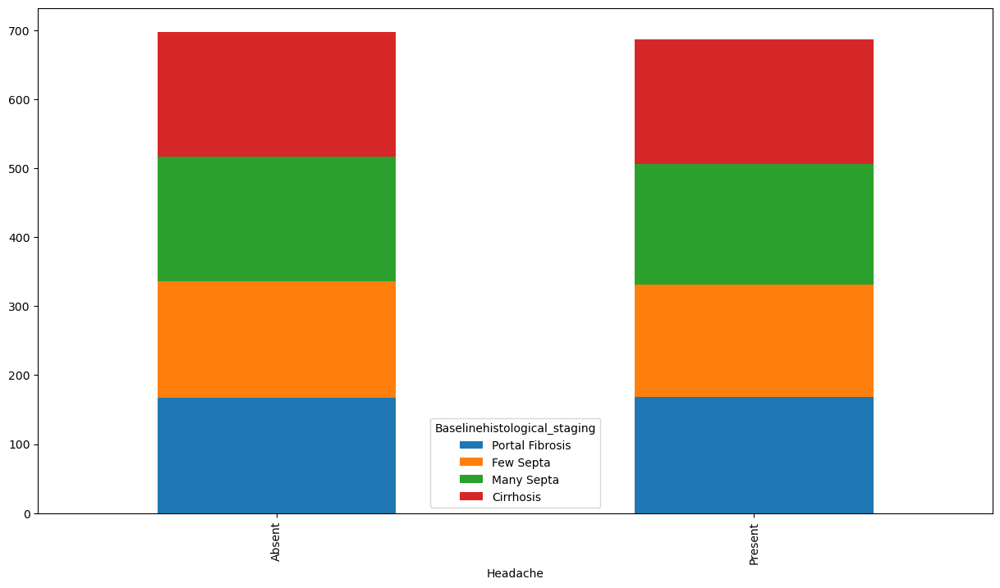

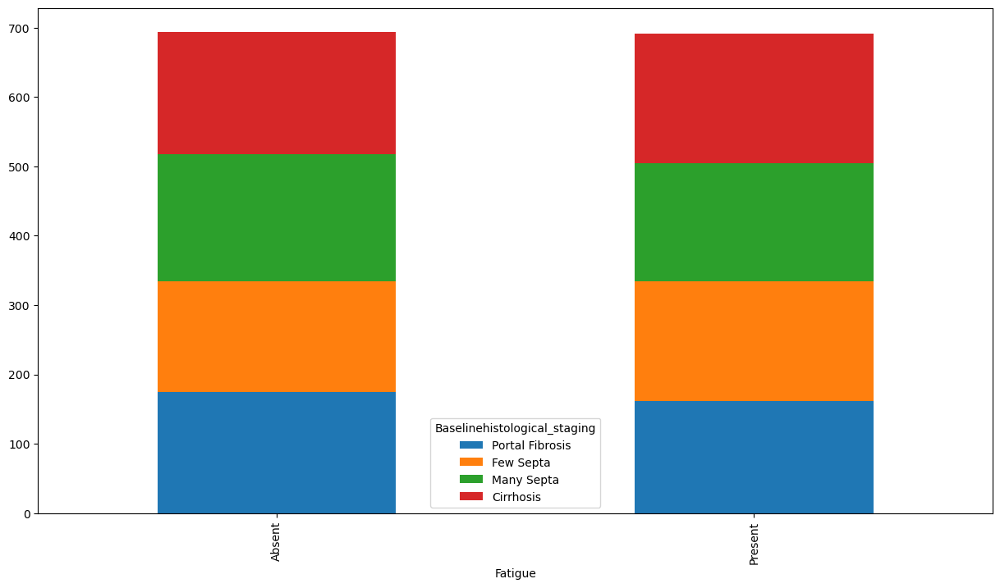

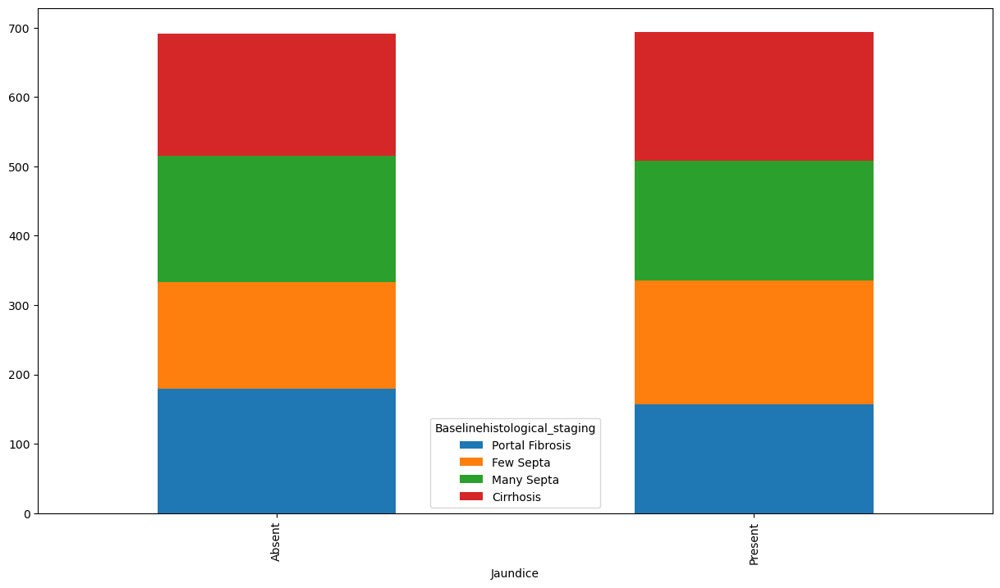

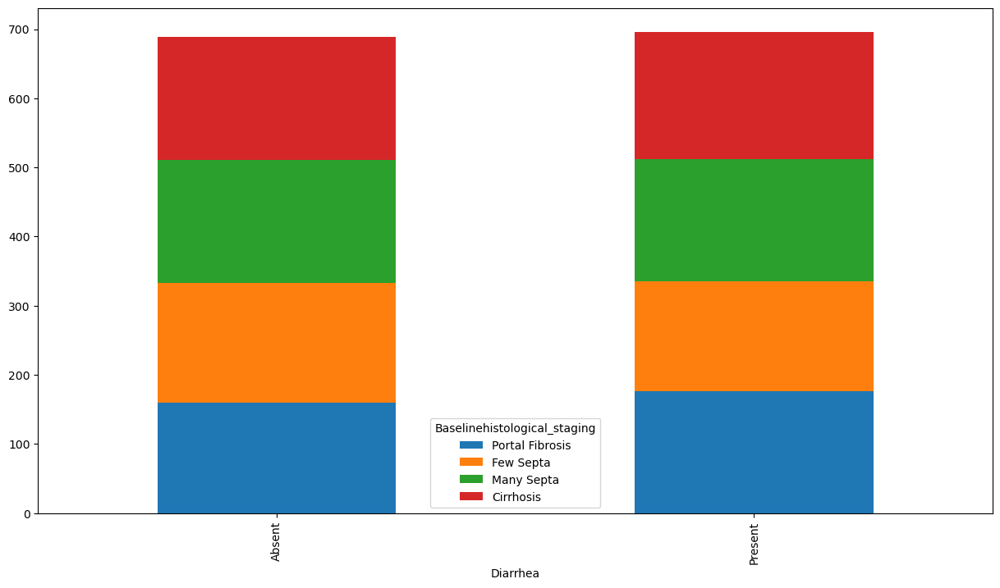

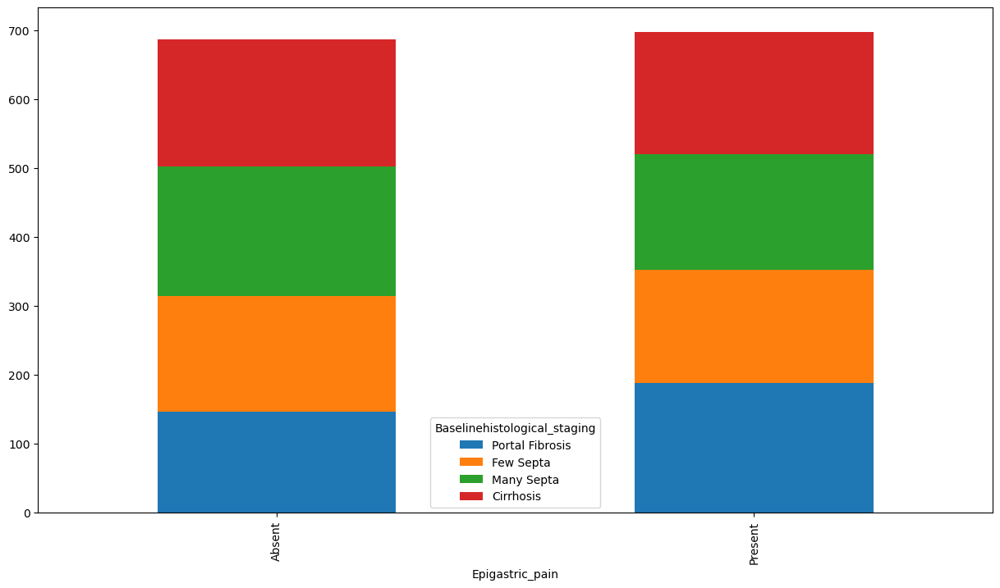

In [48]:
# Visualize the distribution of each categorical variable
for column in df_cat.columns:
    if column != 'Baselinehistological_staging':
        pd.crosstab(df_cat[column], df_cat['Baselinehistological_staging']).plot(kind='bar', stacked=True)

`Inference:`

This plot is a stacked bar chart that shows the distribution of Baselinehistological Staging of Hepatitis C Virus (HCV) patients based on the presence or absence of epigastric pain.

Each bar represents a category of epigastric pain: "Absent" on the left and "Present" on the right. Within each bar, different colors represent the stages of liver disease:

- Blue represents "Portal Fibrosis"
- Orange represents "Few Septa"
- Green represents "Many Septa"
- Red represents "Cirrhosis"

The height of each color segment within the bars indicates the number of patients in each histological stage with either absent or present epigastric pain.

The chart aims to compare the severity of liver disease in patients with and without epigastric pain. For instance, if the red section (Cirrhosis) is significantly larger in the "Present" category, it could suggest that patients with epigastric pain are more likely to have more advanced liver disease. Conversely, if the blue section (Portal Fibrosis) is higher in the "Absent" category, it might indicate that patients without epigastric pain are more often in the early stages of liver disease.

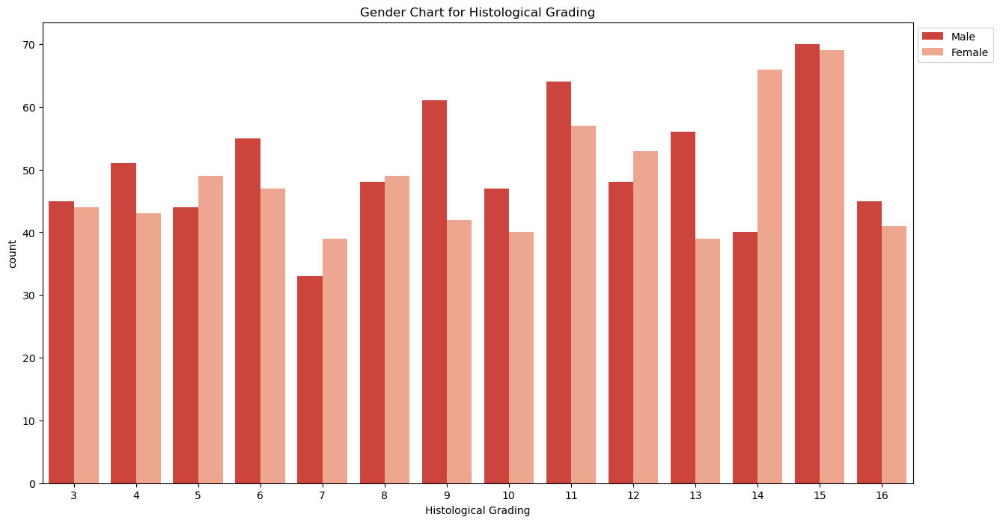

In [49]:
#check Histological Grading and Staging across each Gender

sns.countplot(x=df['Baseline_histological_Grading'],hue=df_cat['Gender'],palette="Reds_r")
plt.title("Gender Chart for Histological Grading")
plt.xlabel("Histological Grading")
plt.legend(bbox_to_anchor=(1,1))
plt.show()

- Most of the cases are in the 15th Grade, also the least are in the 7th Grade.

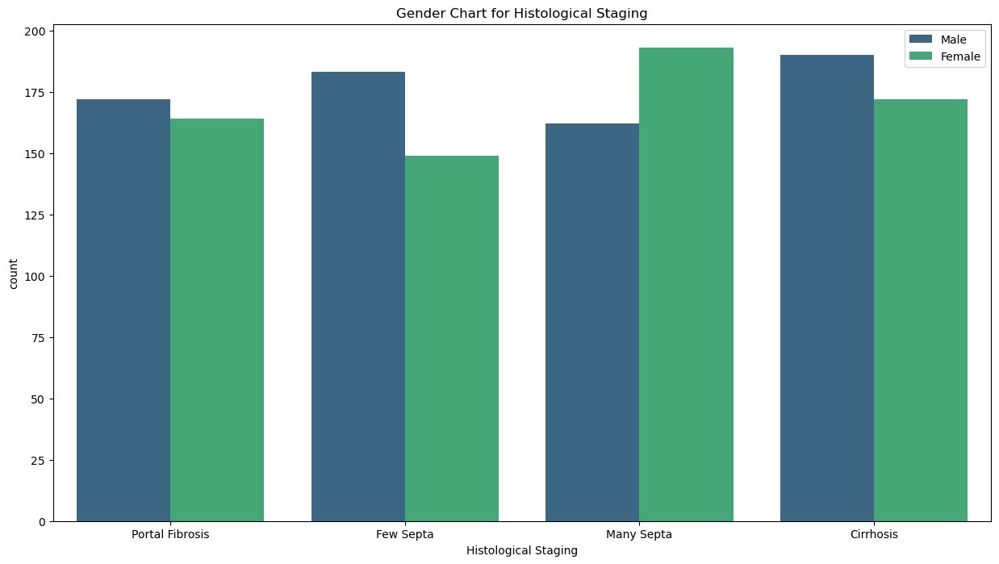

In [50]:
#Histological Stages across each Gender
sns.countplot(x=df_cat['Baselinehistological_staging'],hue=df_cat['Gender'],palette="viridis")
plt.legend(bbox_to_anchor=(1,1))
plt.title("Gender Chart for Histological Staging")
plt.xlabel("Histological Staging")
plt.show()

`Inference:`

- The chart allows for a comparison between the number of males and females across different stages of liver disease. For instance, it seems that in the "Portal Fibrosis" stage, there are slightly more males than females, while in the "Cirrhosis" stage, the numbers are nearly equal between genders.

- This type of visualization helps in understanding gender distribution within each histological stage and can be important for medical research and resource allocation in healthcare settings. 

### Visualization for the Symptoms Features and Histological (Grading&Staging)

### Symptoms vs Histological stages across Gender

In [51]:
df_cat['Histological Stages']=df_cat['Baselinehistological_staging']
df_cat['Histological Gradings']=df['Baseline_histological_Grading']

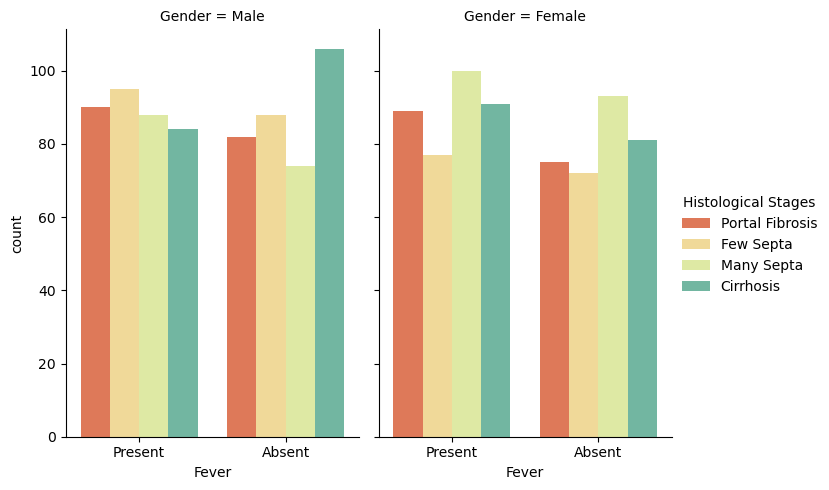

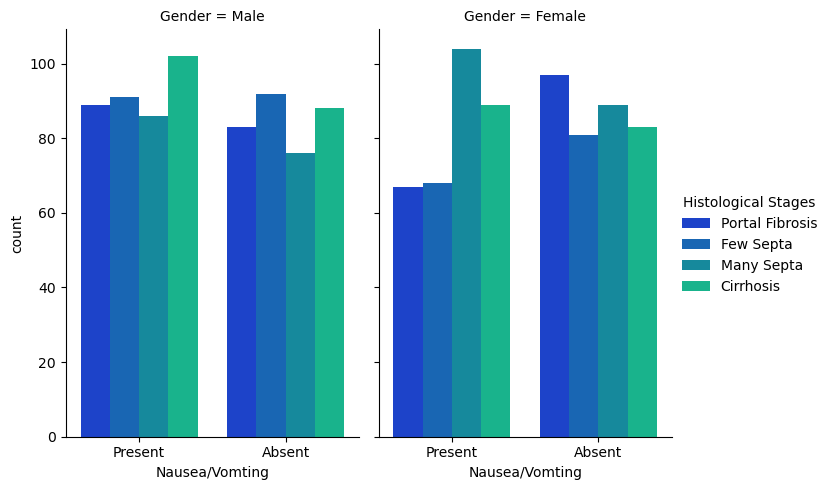

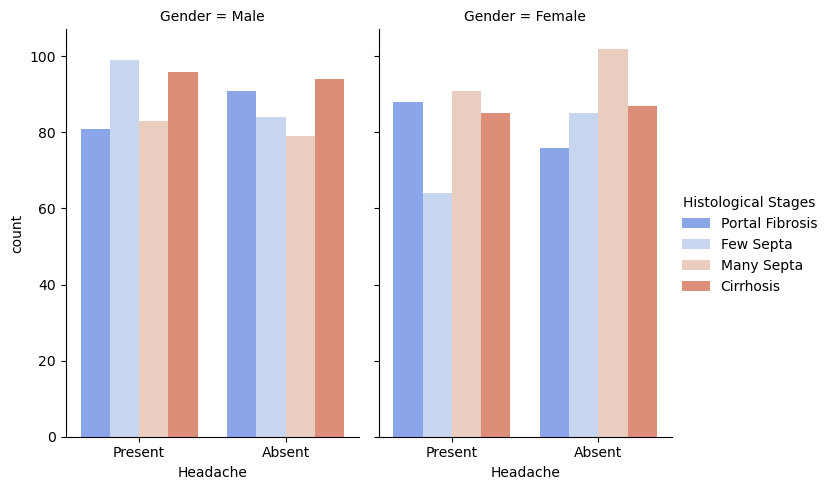

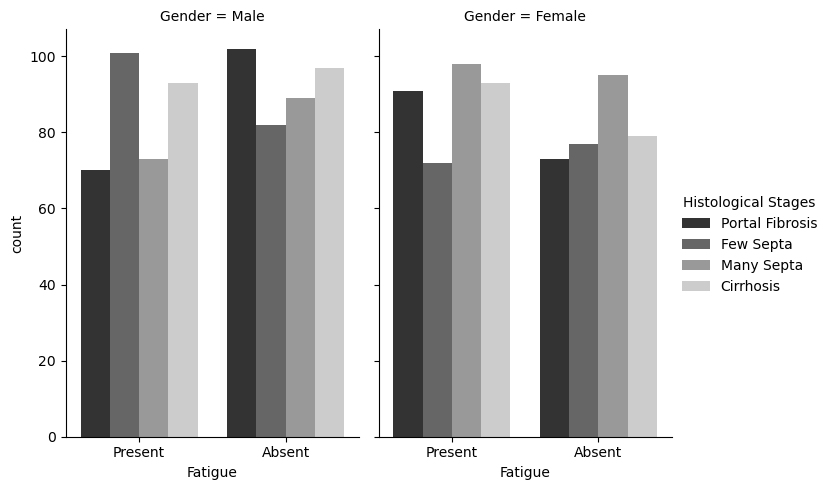

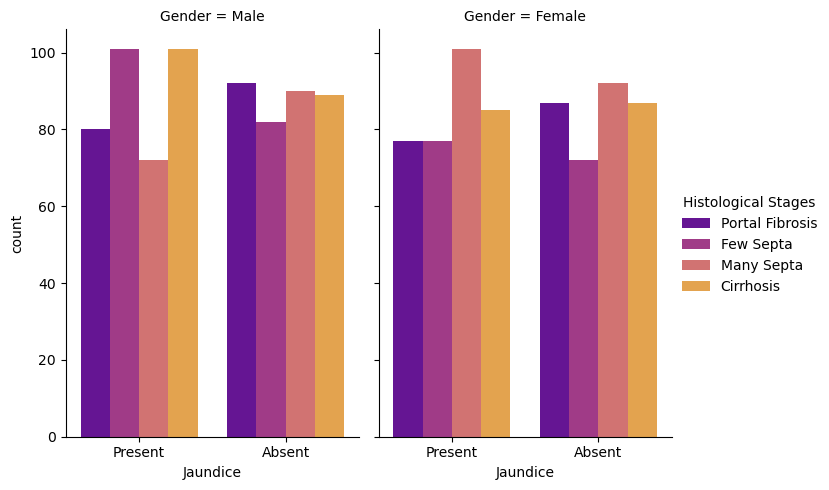

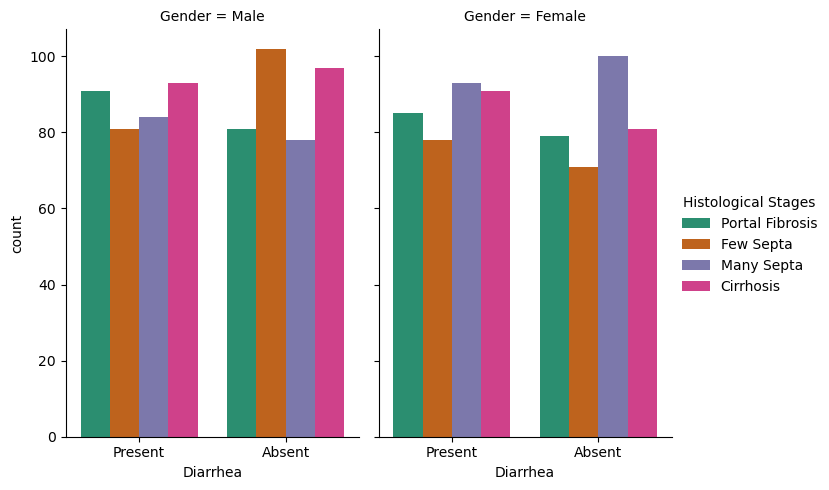

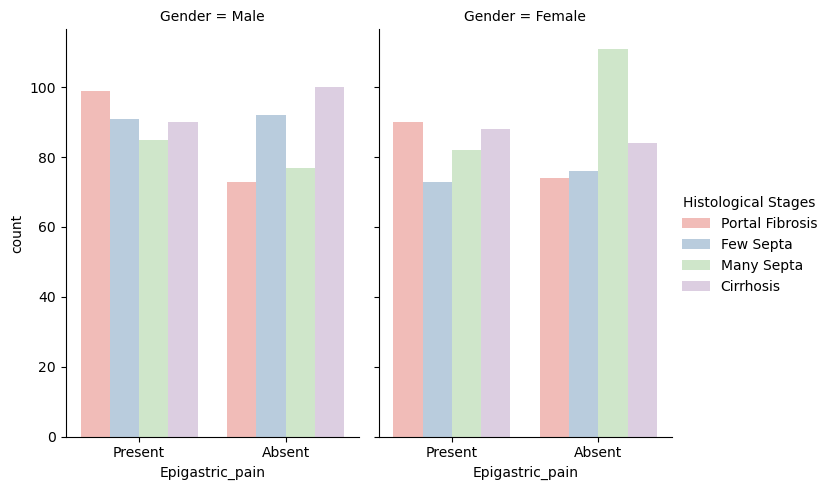

In [52]:
#parameters
order=['Present','Absent']
h_order=['Portal Fibrosis','Few Septa', 'Many Septa', 'Cirrhosis']
height=5
asp=0.7
palette=['winter','Spectral','coolwarm','gist_gray','plasma','Dark2','Pastel1']

#plots
FeverPltS = sns.catplot(x="Fever", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[1])

NauseaPltS =sns.catplot(x="Nausea/Vomting", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[0])


HeadachePltS =sns.catplot(x="Headache", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[2])


FatiguePltS =sns.catplot(x="Fatigue", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[3])


JaundicePltS =sns.catplot(x="Jaundice", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[4])



DiarrheaPltS =sns.catplot(x="Diarrhea", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[5])


Epigastric_painPltS =sns.catplot(x="Epigastric_pain", hue="Histological Stages", col="Gender",
                data=df_cat, kind="count",
                 height=height, aspect=asp,order=order,hue_order=h_order,palette=palette[6])


`Inference:`
    
- On the left side, the chart titled "Gender = Male" shows the count of male patients with and without jaundice across the four stages. Similarly, on the right side, the chart titled "Gender = Female" shows the count of female patients.

- The 'count' on the y-axis likely represents the number of patients, while the 'Jaundice' on the x-axis is divided into 'Present' and 'Absent', indicating whether the patients had jaundice.

- From the charts, we can compare the frequency of jaundice in males and females across different stages of liver disease. It seems that for both genders, jaundice is present across all histological stages, with the counts varying between stages. 

### Aspartate Transaminase

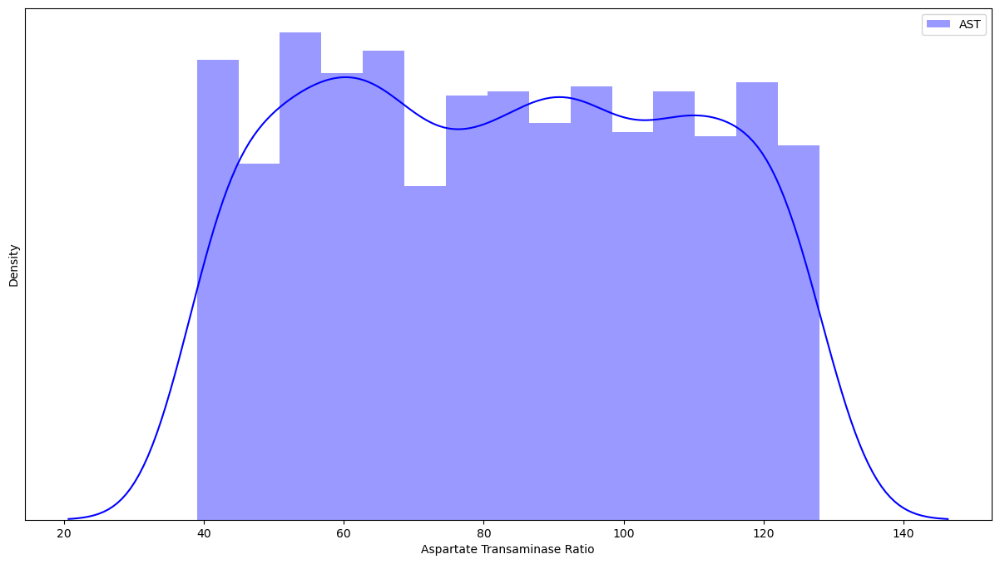

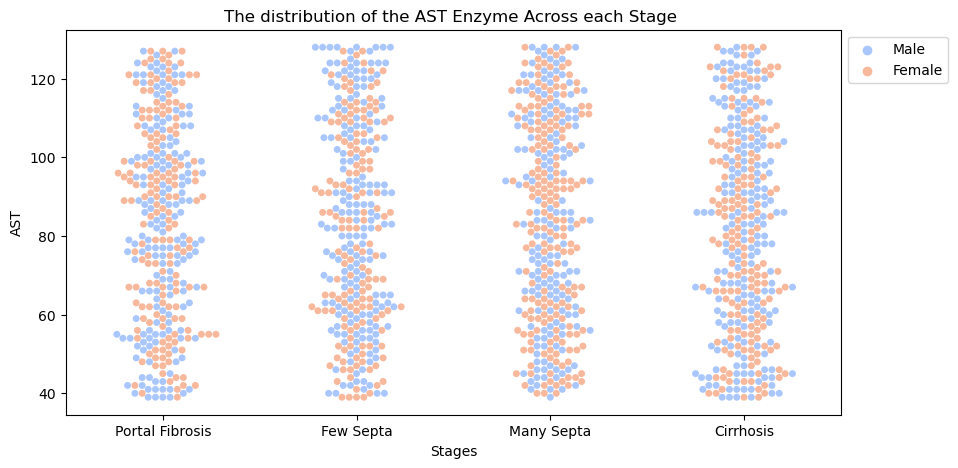

In [53]:
#Aspartate Transminase distribution:

AST=df['AST_1']

sns.distplot(AST,bins=15,label="AST",color="blue")
plt.xlabel("Aspartate Transaminase Ratio")
plt.yticks([])
plt.legend()
plt.show()

#AST vs Stages
plt.figure(figsize=(10,5))
sns.swarmplot(y=df['AST_1'],x=df_cat['Baselinehistological_staging'],hue=df_cat.Gender,palette="coolwarm")
plt.legend(bbox_to_anchor=(1,1))
plt.xlabel("Stages")
plt.ylabel("AST")
plt.title("The distribution of the AST Enzyme Across each Stage ")
plt.show()

`Inference:`

- This plot is a scatter plot displaying the distribution of AST (Aspartate Transaminase) enzyme levels across different histological stages of liver disease, categorized by gender. 

- Each point on the plot represents a single observation (a patient's AST level) within the dataset. The y-axis shows the AST enzyme levels. Blue dots represent male patients and orange dots represent female patients.

From the plot, we can observe the following:

- AST levels vary within each stage and across different stages of liver disease.
- There is a mix of AST levels between male and female patients within each stage, with no clear pattern of one gender having consistently higher or lower levels than the other.
- The plot allows us to visually assess the variability of AST levels within each gender and histological stage. For example, it looks like there is a wide range of AST levels in the Cirrhosis stage for both males and females.

The plot does not show a clear trend or separation between stages or genders, indicating that AST levels alone may not be a distinct marker for differentiating between stages of liver disease or between genders.

### Alanine Transaminase

In [54]:
df_alt = df[['ALT_1', 'ALT_4', 'ALT_12', 'ALT_24', 'ALT_36','ALT_48', 'ALT_after_24w']]
df_alt.head()

,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w
0,84,52.0,109,81,5,5,5
1,123,95.0,75,113,57,123,44
2,49,95.0,107,116,5,5,5
3,64,109.0,80,88,48,77,33
4,104,67.0,48,120,94,90,30


In [55]:
df_alt.columns=['ALT WEEK 1','ALT WEEK 4','ALT WEEK 12','ALT WEEK 24','ALT WEEK 36','ALT WEEK 48',"'ALT after 24 WEEKs '"]

### Distribution for ALT (per each week) and [stages,grading,HBG] for both gender

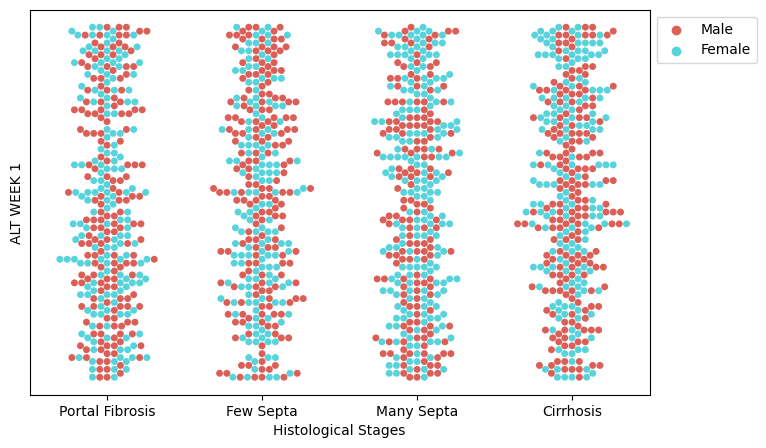

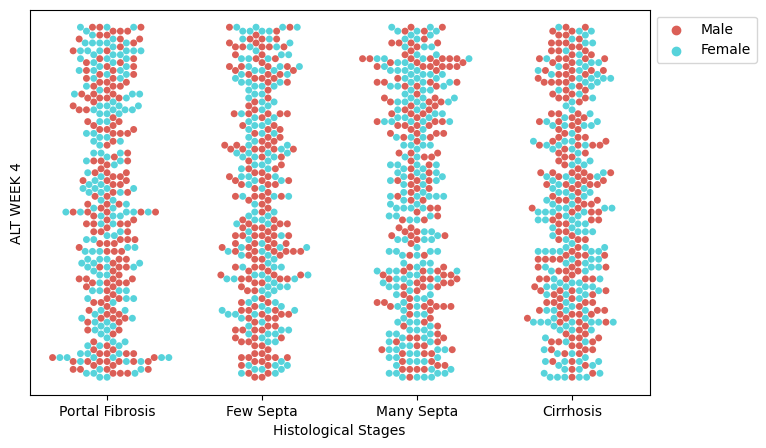

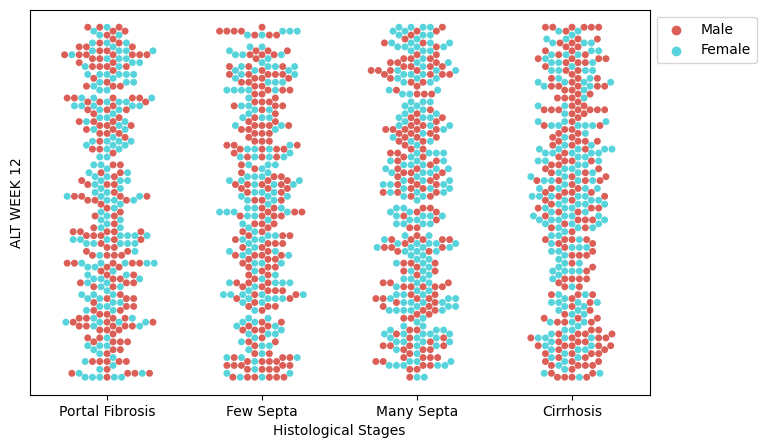

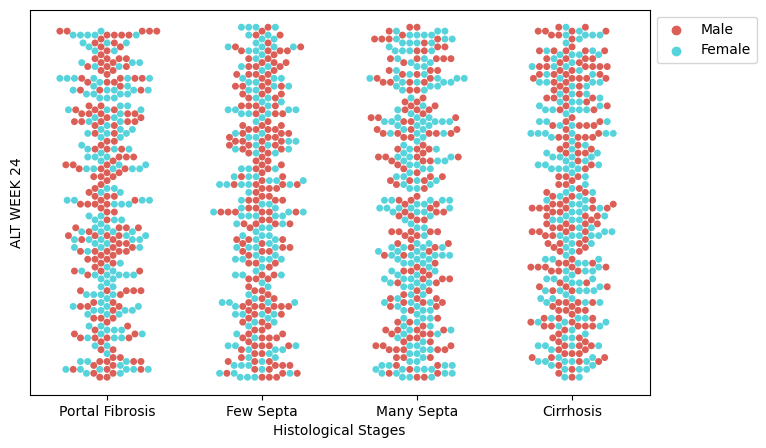

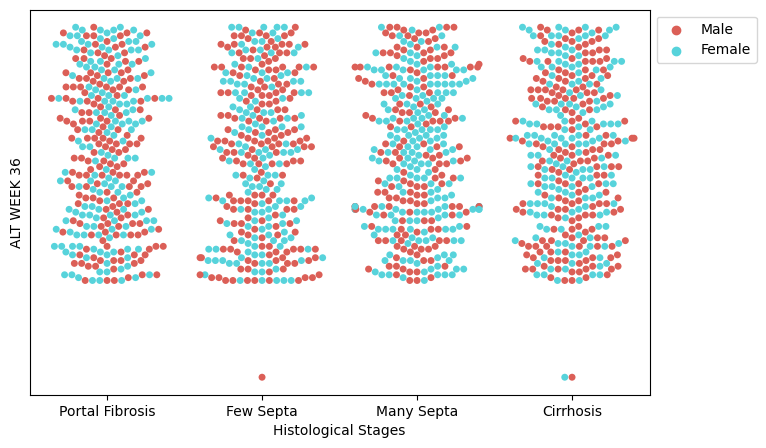

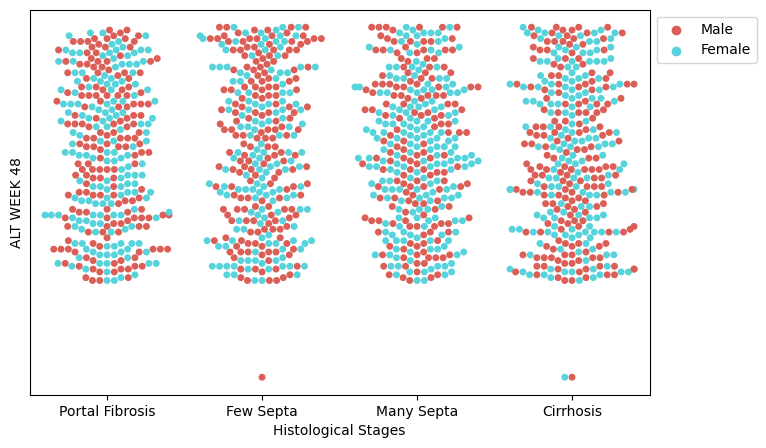

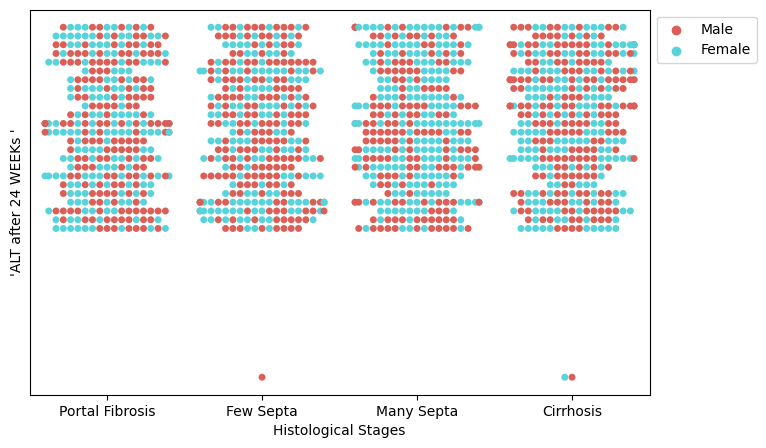

In [56]:
#ALT WEEKS V stages
def ALTSwarmPlot(data,x,hue,figsize,palette):
    for i, col in enumerate(df_alt.columns):
        plt.figure(i,figsize=figsize)
        sns.swarmplot(y=df_alt[col],x=x,hue=hue,palette=palette)
        plt.yticks([])
        plt.legend(bbox_to_anchor=(1,1))
        
ALTSwarmPlot(data=df_alt,x=df_cat['Histological Stages'], figsize=((8,5)),hue=df_cat['Gender'],palette="hls")

`Inference:`

Each scatter plot is distributed vertically by ALT levels for a specific week post-treatment, indicating how ALT levels vary over time in relation to the stage of liver disease. The arrangement allows for a comparison of ALT levels at different times during treatment and monitoring, and whether there are differences in these levels between male and female patients within each stage of liver disease.

A few observations that can be inferred from the plots might include:

- ALT levels vary within each stage and over the weeks measured.
- There is a mix of ALT levels between male and female patients at each time point, without any immediately obvious pattern or distinction between genders across the stages.
- By comparing across the different weeks, one could assess whether the ALT levels generally increase, decrease, or remain stable as time progresses, which can be indicative of the progression or improvement of liver condition in response to treatment.

### RNA Stages

In [57]:
RNAdata=df[['RNA_Base','RNA 4','RNA_12','RNA_EOT','RNA_EF']]
RNAdata.head()

,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF
0,655330,634536,288194,5,5
1,40620,538635,637056,336804,31085
2,571148,661346,5,735945,558829
3,1041941,449939,585688,744463,582301
4,660410,738756,3731527,338946,242861


In [58]:
#RNA at each Stage/Gradings.
def RNASwarmPlot(data,x,hue,figsize,palette):
    for i, col in enumerate(RNAdata.columns):
        plt.figure(i,figsize=figsize)
        sns.swarmplot(y=RNAdata[col],x=x,hue=hue,palette=palette)
        plt.legend(bbox_to_anchor=(1,1))

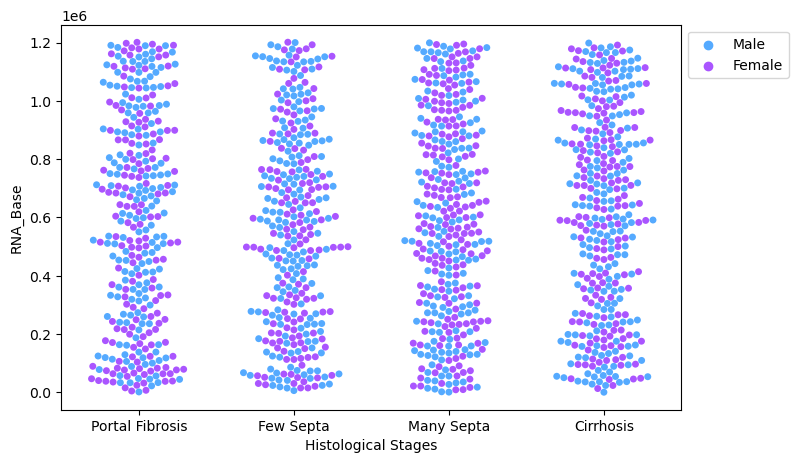

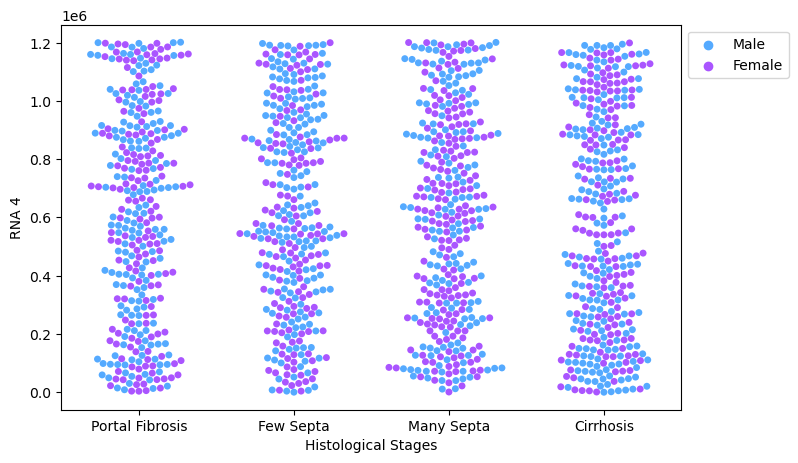

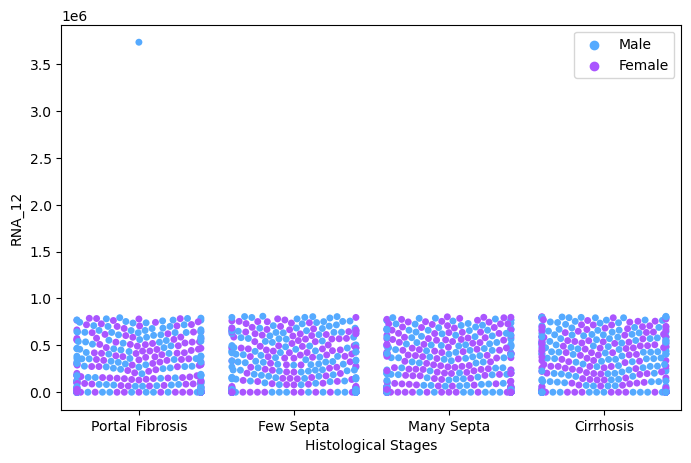

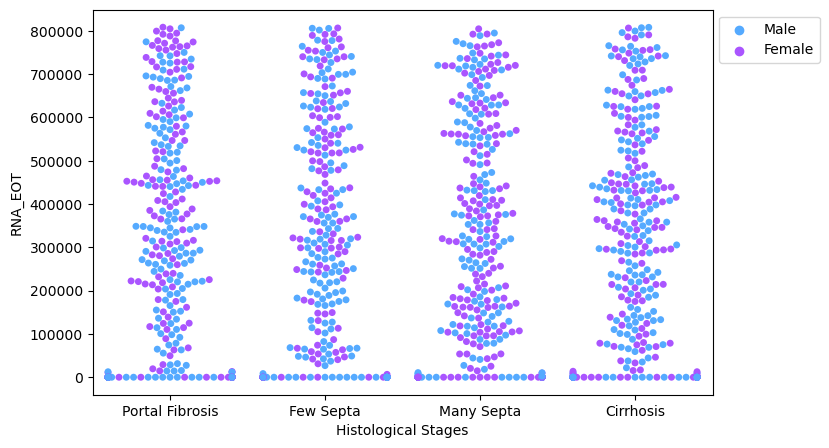

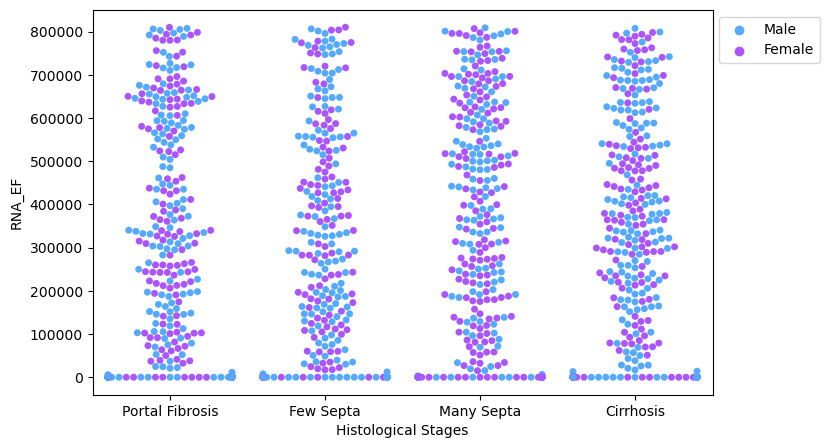

In [59]:
#RNA VS STAGES
RNASwarmPlot(data=df,x=df_cat['Histological Stages'],figsize=(8,5),palette="cool",hue=df_cat['Gender'])

`Inference:`

From the plots, we can see that:

- RNA levels are distributed across all stages of liver disease for both genders.
- At the RNA Base level, RNA 4, and RNA 12, there is a wide distribution of viral load levels among patients in all stages, suggesting variability in how patients present and respond to treatment.
- The RNA EOT and RNA EF scatter plots indicate a decrease in viral load, showing many points clustered at the lower end of the y-axis, which would be expected if patients respond well to treatment.

### Statistical Analysis

In [60]:
df_cat.drop(['Histological Stages', 'Histological Gradings'],axis = 1, inplace = True)

In [61]:
df_cat.head()

,Gender,Fever,Nausea/Vomting,Headache,Fatigue,Jaundice,Diarrhea,Epigastric_pain,Baselinehistological_staging
0,Male,Present,Absent,Absent,Present,Present,Absent,Present,Few Septa
1,Male,Absent,Present,Present,Present,Present,Absent,Absent,Few Septa
2,Male,Present,Present,Present,Absent,Absent,Present,Absent,Cirrhosis
3,Female,Absent,Present,Absent,Absent,Present,Present,Absent,Many Septa
4,Male,Absent,Absent,Present,Present,Present,Absent,Present,Portal Fibrosis


#### For categorical columns

In [62]:
from scipy.stats import chi2_contingency

# Perform chi-square test for each categorical variable
for column in df_cat.columns:
    if column != 'Baselinehistological_staging':
        contingency_table = pd.crosstab(df_cat[column], df_cat['Baselinehistological_staging'])
        chi2, p, dof, expected = chi2_contingency(contingency_table)
        print(f"Chi-square test for {column}: p-value = {p}")

Chi-square test for Gender: p-value = 0.08318737457020528
Chi-square test for Fever: p-value = 0.5356332988397037
Chi-square test for Nausea/Vomting: p-value = 0.16217902183179256
Chi-square test for Headache: p-value = 0.9821273061728452
Chi-square test for Fatigue: p-value = 0.589280639706306
Chi-square test for Jaundice: p-value = 0.29896566634958105
Chi-square test for Diarrhea: p-value = 0.7010432291061677
Chi-square test for Epigastric_pain: p-value = 0.08759780229199586


`Inference:`
    
- From the chi-square tests, p-values lower than a selected level of significance (e.g., 0.05) usually indicate a significant association between the categorical variable and target variable. In our case no p-values are less than 0.05, which means that non of these factors have significant association with the target variable Baselinehistological_staging at 0.05 level.

- However, choosing significance level is arbitrary and could be adjusted according to our specific needs and circumstances of our analysis. Statistically, while signiﬁcance is critical in evaluating whether or not a predictor is important; there are other things to consider as well.

#### For numeric columns

In [63]:
df_num.head(2)

,Age,BMI,WBC,RBC,HGB,Plat,AST_1,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF,Baseline_histological_Grading
0,56,35,7425,4248807.0,14,112132.0,99,84,52.0,109,81,5,5,5,655330,634536,288194,5,5,13
1,46,29,12101,4429425.0,10,129367.0,91,123,95.0,75,113,57,123,44,40620,538635,637056,336804,31085,4


In [64]:
from scipy.stats import f_oneway

# Perform ANOVA for each numerical variable
for column in df_num.columns:
    f_statistic, p_value = f_oneway(df_num[column], df['Baselinehistological_staging'])
    print(f"ANOVA for {column}: p-value = {p_value}")

ANOVA for Age: p-value = 0.0
ANOVA for BMI: p-value = 0.0
ANOVA for WBC: p-value = 0.0
ANOVA for RBC: p-value = 0.0
ANOVA for HGB: p-value = 0.0
ANOVA for Plat: p-value = 0.0
ANOVA for AST_1: p-value = 0.0
ANOVA for ALT_1: p-value = 0.0
ANOVA for ALT_4: p-value = 0.0
ANOVA for ALT_12: p-value = 0.0
ANOVA for ALT_24: p-value = 0.0
ANOVA for ALT_36: p-value = 0.0
ANOVA for ALT_48: p-value = 0.0
ANOVA for ALT_after_24w: p-value = 0.0
ANOVA for RNA_Base: p-value = 0.0
ANOVA for RNA 4: p-value = 0.0
ANOVA for RNA_12: p-value = 5.939803316101762e-251
ANOVA for RNA_EOT: p-value = 1.194969937533851e-281
ANOVA for RNA_EF: p-value = 4.098330501007371e-282
ANOVA for Baseline_histological_Grading: p-value = 0.0


`Inference:`
    
- The results of the ANOVA tests indicate that all numerical variables have extremely low p-values (close to zero), suggesting that there are significant differences in means across the categories of the target variable (Baselinehistological_staging).

### Model Building

In [65]:
X_scaler = StandardScaler()
num_scaled = X_scaler.fit_transform(df_num)
df_num_scaled = pd.DataFrame(num_scaled, columns = df_num.columns)

df_num_scaled.head(2)

,Age,BMI,WBC,RBC,HGB,Plat,AST_1,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF,Baseline_histological_Grading
0,1.102814,1.568525,-0.040636,-0.500596,0.824497,-1.191726,0.624437,0.003232,-1.184223,0.978295,-0.103412,-2.960181,-2.999471,-4.021808,0.181960,0.092882,-0.001962,-1.087692,-1.088823,0.805050
1,-0.036355,0.096039,1.712476,0.021071,-1.510734,-0.747305,0.316553,1.508243,0.437185,-0.326634,1.118124,-0.989700,1.501857,1.493666,-1.555454,-0.171903,1.221053,0.185824,-0.972681,-1.432396


In [66]:
dummy = pd.get_dummies(df_cat.drop('Baselinehistological_staging',axis = 1), drop_first = True)
dummy.head(2)

,Gender_Female,Fever_Present,Nausea/Vomting_Present,Headache_Present,Fatigue_Present,Jaundice_Present,Diarrhea_Present,Epigastric_pain_Present
0,0,1,0,0,1,1,0,1
1,0,0,1,1,1,1,0,0


In [67]:
X = pd.concat([df_num_scaled, dummy], axis = 1)
X.head()

,Age,BMI,WBC,RBC,HGB,Plat,AST_1,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF,Baseline_histological_Grading,Gender_Female,Fever_Present,Nausea/Vomting_Present,Headache_Present,Fatigue_Present,Jaundice_Present,Diarrhea_Present,Epigastric_pain_Present
0,1.102814,1.568525,-0.040636,-0.500596,0.824497,-1.191726,0.624437,0.003232,-1.184223,0.978295,-0.103412,-2.960181,-2.999471,-4.021808,0.181960,0.092882,-0.001962,-1.087692,-1.088823,0.805050,0,1,0,0,1,1,0,1
1,-0.036355,0.096039,1.712476,0.021071,-1.510734,-0.747305,0.316553,1.508243,0.437185,-0.326634,1.118124,-0.989700,1.501857,1.493666,-1.555454,-0.171903,1.221053,0.185824,-0.972681,-1.432396,0,0,1,1,1,1,0,0
2,1.216730,1.077696,-1.257991,0.574935,-0.343119,-0.176017,1.163233,-1.347418,0.437185,0.901534,1.232643,-2.960181,-2.999471,-4.021808,-0.055972,0.166905,-1.012273,1.695069,0.999427,-1.432396,0,1,1,1,0,0,1,0
3,0.305396,1.077696,-0.391183,1.075870,-1.510734,-0.306623,-1.530748,-0.768568,0.965086,-0.134733,0.163799,-1.330745,-0.252898,-0.061981,1.274675,-0.416795,1.040971,1.727277,1.087139,0.059234,1,0,1,0,0,1,1,0
4,1.444564,0.832282,-1.451824,0.532143,-0.926927,0.756456,0.624437,0.775032,-0.618616,-1.362901,1.385335,0.412373,0.243011,-0.486248,0.196318,0.380636,12.069419,0.193923,-0.181303,0.307840,0,0,0,1,1,1,0,1


In [68]:
df['Baselinehistological_staging'].replace([1],[0],inplace=True)
df['Baselinehistological_staging'].replace([2],[1],inplace=True)
df['Baselinehistological_staging'].replace([3],[1],inplace=True)
df['Baselinehistological_staging'].replace([4],[1],inplace=True)

In [69]:
y= df[['Baselinehistological_staging']]
y.head()

,Baselinehistological_staging
0,1
1,1
2,1
3,1
4,0


In [70]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print('X_train', X_train.shape)
print('y_train', y_train.shape)
print('X_test', X_test.shape)
print('y_test', y_test.shape)

X_train (1108, 28)
y_train (1108, 1)
X_test (277, 28)
y_test (277, 1)


### Random Forest Classifier

In [71]:
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)
print('Train Score:', rf.score(X_train, y_train))
print('Test Score:', rf.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.7617328519855595


In [72]:
labels = X_train.columns

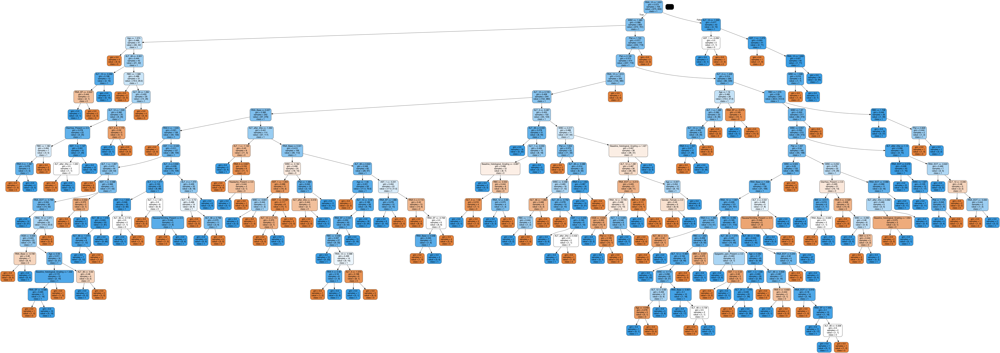

In [73]:
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

# Select one of the trees from the random forest
tree = rf.estimators_[0]  # Change the index if you want a different tree

# Export the selected tree to DOT format
dot_data = export_graphviz(tree, feature_names=labels, class_names=["0", "1"], filled=True, rounded=True)

# Create a graph from DOT data
graph = pydotplus.graph_from_dot_data(dot_data)

# Display the decision tree
Image(graph.create_png())

### Gradient Boost Classifier

In [74]:
gb = GradientBoostingClassifier(random_state=42)
gb.fit(X_train, y_train)
print('Train Score:', gb.score(X_train, y_train))
print('Test Score:', gb.score(X_test, y_test))

Train Score: 0.8456678700361011
Test Score: 0.7364620938628159


### Decision Tree Classifier

In [75]:
dt = DecisionTreeClassifier(random_state=42)
dt.fit(X_train, y_train)
print('Train Score:', dt.score(X_train, y_train))
print('Test Score:', dt.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.5595667870036101


### AdaBoost Classifier

In [76]:
ada = AdaBoostClassifier(random_state=42)
ada.fit(X_train, y_train)
print('Train Score:', ada.score(X_train, y_train))
print('Test Score:', ada.score(X_test, y_test))

Train Score: 0.7680505415162455
Test Score: 0.740072202166065


### Bagging Classifier

In [77]:
bag = BaggingClassifier(random_state=42)
bag.fit(X_train, y_train)
print('Train Score:', bag.score(X_train, y_train))
print('Test Score:', bag.score(X_test, y_test))

Train Score: 0.9918772563176895
Test Score: 0.7184115523465704


### XGB Classifier

In [78]:
xgb = XGBClassifier(random_state = 42)
xgb.fit(X_train, y_train)
print('Train Score:', xgb.score(X_train, y_train))
print('Test Score:', xgb.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.7617328519855595


### Voting Classifier

In [79]:
from sklearn.ensemble import VotingClassifier

estimator = [('RF',RandomForestClassifier()),
             ('XGB',XGBClassifier())]
vot = VotingClassifier(estimators=estimator,voting='soft')

In [80]:
vot = vot
vot.fit(X_train, y_train)
print('Train Score:', vot.score(X_train, y_train))
print('Test Score:', vot.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.7581227436823105


### Scorecard

In [81]:
scorecard = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1_score', 'Train_Accuracy', 'Test_Accuracy'])

def model_accuracy(model_name, classifier, X_train, y_train, X_test, y_test):
    
    # training data 
    model = classifier.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    # testing data
    y_test_pred = model.predict(X_test)
    
    Train_accuracy = model.score(X_train, y_train)
    Test_accuracy = model.score(X_test, y_test)
    
    global scorecard
    scorecard = pd.concat([scorecard, pd.DataFrame({'Model': [model_name],
                                                    'Precision': [precision_score(y_test, y_test_pred, average='weighted')],
                                                    'Recall': [recall_score(y_test, y_test_pred, average='weighted')],
                                                    'F1_score': [f1_score(y_test, y_test_pred, average='weighted')],
                                                    'Train_Accuracy': [Train_accuracy],
                                                    'Test_Accuracy': [Test_accuracy]})], ignore_index=True)

In [82]:
model_accuracy('Random Forest', rf, X_train, y_train, X_test, y_test)
model_accuracy('Decision tree', dt, X_train, y_train, X_test, y_test)
model_accuracy('Gradient Boost', gb, X_train, y_train, X_test, y_test)
model_accuracy('XGB Classifier', xgb, X_train, y_train, X_test, y_test)
model_accuracy('Ada Boost Forest', ada, X_train, y_train, X_test, y_test)
model_accuracy('Voting Classifier', vot, X_train, y_train, X_test, y_test)
model_accuracy('Bagging Classifier', bag, X_train, y_train, X_test, y_test)

In [83]:
scorecard

,Model,Precision,Recall,F1_score,Train_Accuracy,Test_Accuracy
0,Random Forest,0.580237,0.761733,0.658712,1.000000,0.761733
1,Decision tree,0.617782,0.559567,0.583494,1.000000,0.559567
2,Gradient Boost,0.621780,0.736462,0.657535,0.845668,0.736462
3,XGB Classifier,0.709983,0.761733,0.697366,1.000000,0.761733
4,Ada Boost Forest,0.658162,0.740072,0.674593,0.768051,0.740072
5,Voting Classifier,0.677808,0.758123,0.669492,1.000000,0.758123
6,Bagging Classifier,0.666411,0.718412,0.683281,0.991877,0.718412


`Inference:`

From the scorecard, we can observe the following:

1. The **Random Forest** model has a moderate recall but the lowest precision and a considerable gap between training and test accuracy, indicating potential overfitting.

2. The **Decision Tree** model has the lowest recall and test accuracy, suggesting that it might be too simple to capture the complexity of the data.

3. The **Gradient Boost** model shows better balance between precision and recall, with a higher F1 score than Random Forest and Decision Tree, and a good balance between train and test accuracy.

4. The **XGB Classifier** has the highest F1 score, indicating a good balance between precision and recall. However, it also displays a perfect training accuracy, which could be a sign of overfitting, as reflected in the test accuracy.

5. **Ada Boost Forest** shows good recall and a decent F1 score, with more balanced accuracy scores between training and testing, indicating a better generalization than some of the other models.

6. The **Voting Classifier** appears to have a good balance of precision, recall, and F1 score, with a high training and test accuracy, which might make it the best generalized model among those listed.

7. Lastly, the **Bagging Classifier** has the highest precision and a strong F1 score, with very high training accuracy and reasonably high test accuracy, which could also indicate good generalization but with a slight inclination towards overfitting.

The decision on which model to use will depend on the specific use case and whether precision or recall is more important. For instance, in medical diagnostics, high recall might be preferred to ensure as few false negatives as possible, even at the expense of precision.

### ROC_AUC Curve

In [84]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

def plot_roc_curves_subplots(models, X_test, y_test):
    num_models = len(models)
    fig, axs = plt.subplots(nrows=1, ncols=num_models, figsize=(15, 5))
    
    for i, (name, model) in enumerate(models.items()):
        ax = axs[i] if num_models > 1 else axs  # Handle single plot case
        y_pred_prob = model.predict_proba(X_test)[:, 1]
        fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
        roc_auc = auc(fpr, tpr)
        
        ax.plot(fpr, tpr, lw=2, label='{} (AUC = {:.2f})'.format(name, roc_auc))
        ax.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        ax.set_xlim([0.0, 1.0])
        ax.set_ylim([0.0, 1.05])
        ax.set_xlabel('False Positive Rate (1 - Specificity)')
        ax.set_ylabel('True Positive Rate (Sensitivity)')
        ax.set_title('{} ROC Curve'.format(name))
        ax.legend(loc="lower right")
    
    plt.tight_layout()
    plt.show()

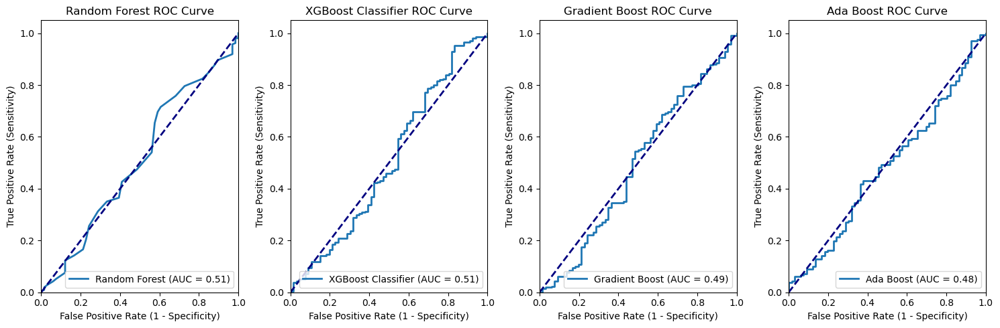

In [85]:
models = {'Random Forest': rf,
         'XGBoost Classifier': xgb,
         'Gradient Boost': gb,
         'Ada Boost': ada}

plot_roc_curves_subplots(models, X_test, y_test)

`Inference:`

Here's what each curve indicates:

1. **Random Forest ROC Curve**: Shows the performance of the Random Forest classifier with an Area Under Curve (AUC) of 0.51. An AUC of 0.5 indicates that the model has no discrimination capability to distinguish between positive and negative classes.

2. **XGBoost Classifier ROC Curve**: Shows the performance of the XGBoost classifier with an AUC of 0.51, which is similar to flipping a coin.

3. **Gradient Boost ROC Curve**: Shows the performance of the Gradient Boost classifier with an AUC of 0.49. This is slightly less than 0.5, which suggests that the model is performing worse than random guessing.

4. **Ada Boost ROC Curve**: Shows the performance of the Ada Boost classifier with an AUC of 0.48, also indicating a performance worse than random guessing.

In general, an AUC closer to 1 indicates a better-performing model, while an AUC closer to 0.5 suggests no predictive power. These particular models are not performing well on the dataset since their AUC scores are near or below 0.5, suggesting that they have no better accuracy than random chance.

### Confusion Matrix

In [86]:
def plot_confusion_matrices(models, model_names):
    num_models = len(models)
    fig, axes = plt.subplots(2, num_models // 2 + num_models % 2, figsize=(15, 12))

    for i, (model, name) in enumerate(zip(models, model_names)):
        ax = axes[i // 2, i % (num_models // 2 + num_models % 2)]  # Select the subplot
        y_pred = model.predict(X_test)
        cm = confusion_matrix(y_test, y_pred)

        conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted:1'], index=['Actual:0', 'Actual:1'])

        sns.heatmap(conf_matrix, annot=True, fmt='d', cbar=False, linewidths=0.1, annot_kws={'size': 25}, ax=ax)
        ax.set_title(name)
        ax.set_xlabel('Predicted label')
        ax.set_ylabel('True label')
        ax.tick_params(axis='both', which='major', labelsize=12)

        # Print classification report
        report = classification_report(y_test, y_pred)
        print(f"Classification Report for {name}:")
        print(report)

    plt.tight_layout()
    plt.show()

Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        66
           1       0.76      1.00      0.86       211

    accuracy                           0.76       277
   macro avg       0.38      0.50      0.43       277
weighted avg       0.58      0.76      0.66       277

Classification Report for XGB Classifier:
              precision    recall  f1-score   support

           0       0.50      0.11      0.17        66
           1       0.78      0.97      0.86       211

    accuracy                           0.76       277
   macro avg       0.64      0.54      0.52       277
weighted avg       0.71      0.76      0.70       277

Classification Report for Gradient Boost:
              precision    recall  f1-score   support

           0       0.18      0.03      0.05        66
           1       0.76      0.96      0.85       211

    accuracy                           0.74       277
   

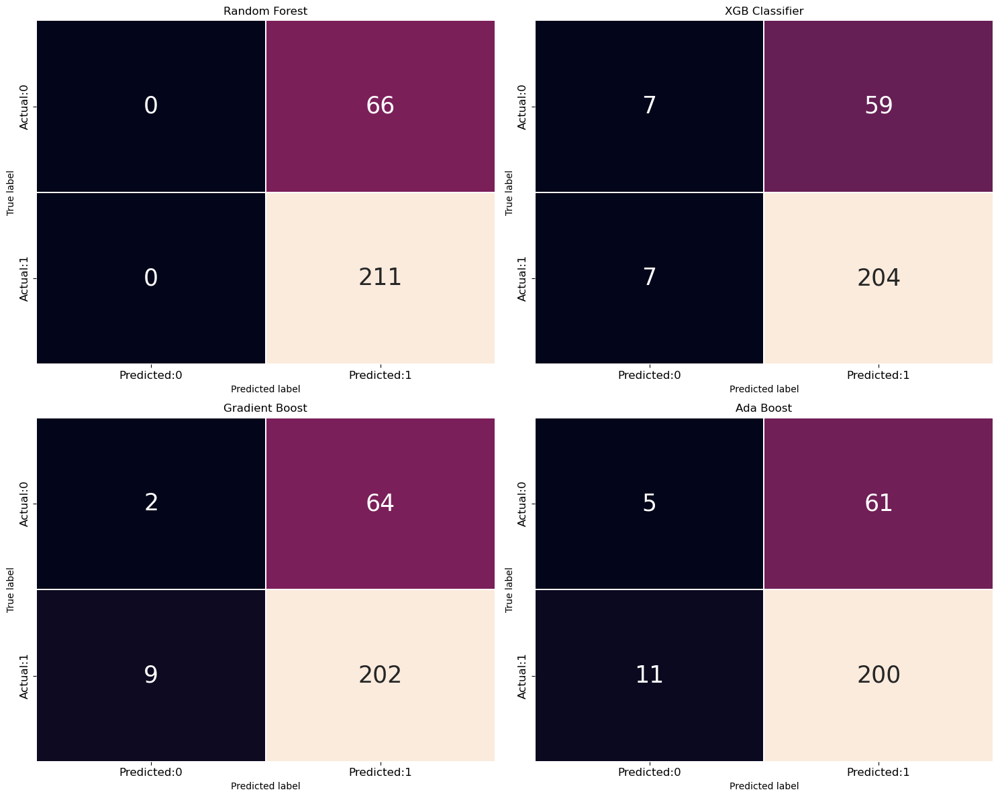

In [87]:
models = [rf, xgb, gb, ada]
model_names = ['Random Forest', 'XGB Classifier', 'Gradient Boost', 'Ada Boost']
plot_confusion_matrices(models, model_names)

In [88]:
y.value_counts()

Baselinehistological_staging
1                               1049
0                                336
dtype: int64

`Inference:`
    
- Very interesting point to be noticed from this confusion matrix.
- We have very low scores for class '0' label. Why?
- The reason is there is huge imbalance in the data. There are only 336 '0' classes and 1049 '1' classes. So, the model is predicting everything as class '1'.
- We can apply SMOTE to handle this imbalance in the data.

### SMOTE

In [89]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [90]:
print('X_train_resampled', X_train_resampled.shape)
print('y_train_resampled', y_train_resampled.shape)

X_train_resampled (1676, 28)
y_train_resampled (1676, 1)


In [91]:
print('X_test:', X_test.shape)
print('y_test:', y_test.shape)

X_test: (277, 28)
y_test: (277, 1)


In [92]:
y_train_resampled.value_counts()

Baselinehistological_staging
0                               838
1                               838
dtype: int64

### Random Forest

In [93]:
sm_rf = RandomForestClassifier(random_state=42)
sm_rf.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_rf.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_rf.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.7328519855595668


In [94]:
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

labels = X_train_resampled.columns
# Select one of the trees from the random forest
tree = sm_rf.estimators_[0]  # Change the index if you want a different tree

# Export the selected tree to DOT format
dot_data = export_graphviz(tree, feature_names=labels, class_names=["0", "1"], filled=True, rounded=True)

# Create a graph from DOT data
graph = pydotplus.graph_from_dot_data(dot_data)

# Display the decision tree
Image(graph.create_png())

### XGB Classifier

In [95]:
sm_xgb = XGBClassifier(random_state=42)
sm_xgb.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_xgb.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_xgb.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.7003610108303249


### DecisionTreeClassifier

In [96]:
sm_dt = DecisionTreeClassifier(random_state=42)
sm_dt.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_dt.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_dt.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.5812274368231047


### GradientBoostingClassifier

In [97]:
sm_gb = GradientBoostingClassifier(random_state=42)
sm_gb.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_gb.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_gb.score(X_test, y_test))

Train Score: 0.889618138424821
Test Score: 0.7220216606498195


### AdaBoostClassifier

In [98]:
sm_ada = AdaBoostClassifier(random_state=42)
sm_ada.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_ada.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_ada.score(X_test, y_test))

Train Score: 0.7595465393794749
Test Score: 0.628158844765343


### BaggingClassifier

In [99]:
sm_bag = BaggingClassifier(random_state=42)
sm_bag.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_bag.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_bag.score(X_test, y_test))

Train Score: 0.9946300715990454
Test Score: 0.6245487364620939


### VotingClassifier

In [100]:
sm_vot = vot
sm_vot.fit(X_train_resampled, y_train_resampled)
print('Train Score:', sm_vot.score(X_train_resampled, y_train_resampled))
print('Test Score:', sm_vot.score(X_test, y_test))

Train Score: 1.0
Test Score: 0.7148014440433214


In [101]:
scorecard_sm = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1_score', 'Train_Accuracy', 'Test_Accuracy'])

def model_accuracy(model_name, classifier, X_train, y_train, X_test, y_test):
    
    # training data 
    model = classifier.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    # testing data
    y_test_pred = model.predict(X_test)
    
    Train_accuracy = model.score(X_train, y_train)
    Test_accuracy = model.score(X_test, y_test)
    
    global scorecard_sm
    scorecard_sm = pd.concat([scorecard_sm, pd.DataFrame({'Model': [model_name],
                                                    'Precision': [precision_score(y_test, y_test_pred, average='weighted')],
                                                    'Recall': [recall_score(y_test, y_test_pred, average='weighted')],
                                                    'F1_score': [f1_score(y_test, y_test_pred, average='weighted')],
                                                    'Train_Accuracy': [Train_accuracy],
                                                    'Test_Accuracy': [Test_accuracy]})], ignore_index=True)

In [102]:
model_accuracy('Random Forest', sm_rf, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Decision tree', sm_dt, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Gradient Boost', sm_gb, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('XGB Classifier', sm_xgb, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Ada Boost Forest', sm_ada, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Voting Classifier', sm_vot, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Bagging Classifier', sm_bag, X_train_resampled, y_train_resampled, X_test, y_test)

In [103]:
scorecard_sm

,Model,Precision,Recall,F1_score,Train_Accuracy,Test_Accuracy
0,Random Forest,0.666529,0.732852,0.682608,1.000000,0.732852
1,Decision tree,0.627303,0.581227,0.600814,1.000000,0.581227
2,Gradient Boost,0.669453,0.722022,0.685772,0.889618,0.722022
3,XGB Classifier,0.643585,0.700361,0.664629,1.000000,0.700361
4,Ada Boost Forest,0.651949,0.628159,0.638918,0.759547,0.628159
5,Voting Classifier,0.646402,0.711191,0.668390,1.000000,0.711191
6,Bagging Classifier,0.667628,0.624549,0.642109,0.994630,0.624549


`Inference:`
    
From the scorecard, we can infer the following:

- Models like Random Forest, XGB Classifier, and Voting Classifier have perfect training accuracy, indicating they may be overfitting the training data, as reflected by lower test accuracy.
- The Gradient Boost model has the highest test accuracy and a relatively high F1 score, suggesting it might be the best at generalizing to new data among the listed models.
- Precision and recall are more balanced in models such as Random Forest and Gradient Boost, which could be important if the cost of false positives and false negatives is similar.
- The Decision Tree model has lower test accuracy compared to others, indicating that it may not perform as well on unseen data.
- The F1 scores are moderate, which indicates that there is room for improvement in the models' ability to balance precision and recall.

### ROC_AUC Curve

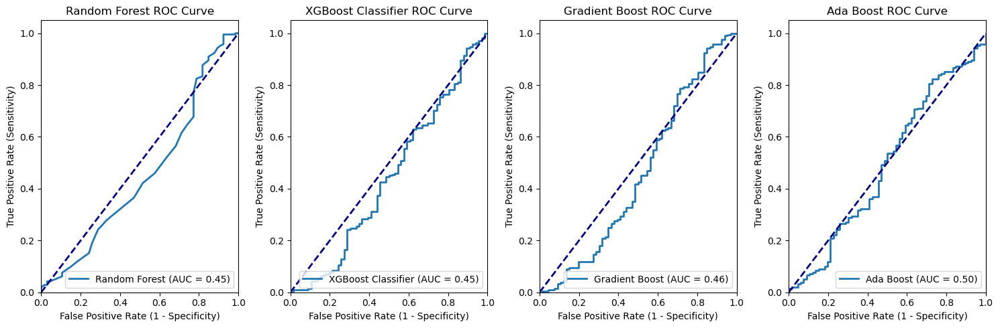

In [104]:
models = {'Random Forest': sm_rf,
         'XGBoost Classifier': sm_xgb,
         'Gradient Boost': sm_gb,
         'Ada Boost': sm_ada}

plot_roc_curves_subplots(models, X_test, y_test)

`Inference:`
    
- In this case, all models have an AUC of less than 0.5, which is unusual and suggests that the models may be performing worse than random guessing. This can happen when the models are predicting inversely - that is, predicting a negative when it's actually positive, and vice versa. It may also be an indication that the models are not well-configured for the dataset or that the data itself may not contain clear signals to differentiate between the classes effectively.

### Confusion Matrix

Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.33      0.12      0.18        66
           1       0.77      0.92      0.84       211

    accuracy                           0.73       277
   macro avg       0.55      0.52      0.51       277
weighted avg       0.67      0.73      0.68       277

Classification Report for XGB Classifier:
              precision    recall  f1-score   support

           0       0.26      0.14      0.18        66
           1       0.76      0.88      0.82       211

    accuracy                           0.70       277
   macro avg       0.51      0.51      0.50       277
weighted avg       0.64      0.70      0.66       277

Classification Report for Gradient Boost:
              precision    recall  f1-score   support

           0       0.33      0.17      0.22        66
           1       0.77      0.90      0.83       211

    accuracy                           0.72       277
   

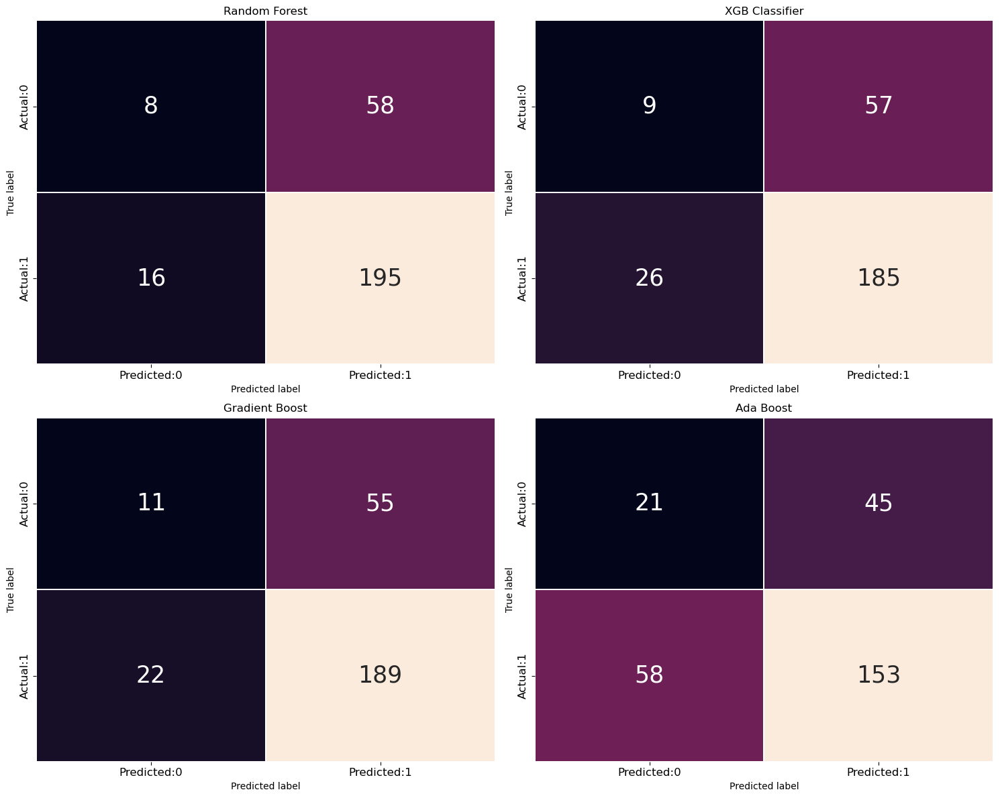

In [105]:
models = [sm_rf, sm_xgb, sm_gb, sm_ada]
model_names = ['Random Forest', 'XGB Classifier', 'Gradient Boost', 'Ada Boost']
plot_confusion_matrices(models, model_names)

In [106]:
# Even after apply smote there are many misclassifications in the for the class label '0'.

In [107]:
y.value_counts()

Baselinehistological_staging
1                               1049
0                                336
dtype: int64

### Feature Selection Methods

In [108]:
sm_rf

RandomForestClassifier(random_state=42)

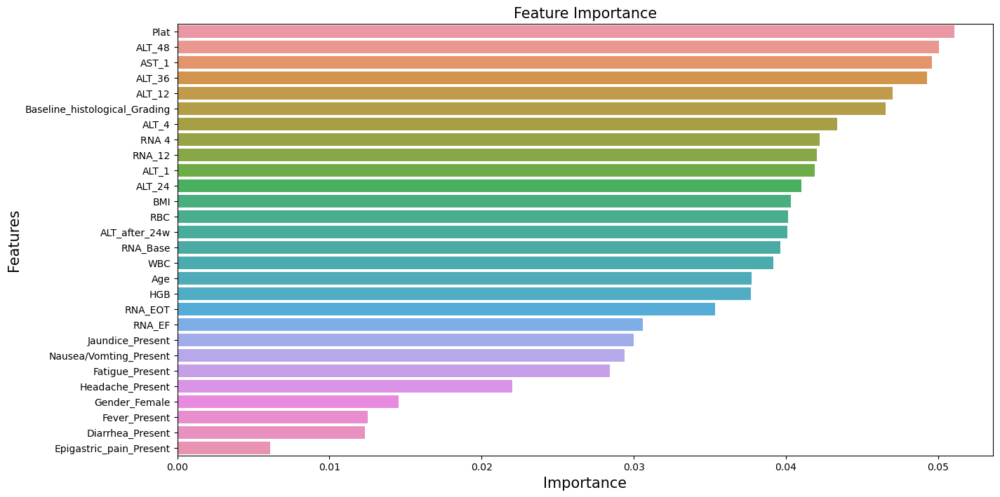

In [109]:
important_features = pd.DataFrame({'Features': X_train_resampled.columns, 
                                   'Importance': sm_rf.feature_importances_})

important_features = important_features.sort_values('Importance', ascending = False)

sns.barplot(x = 'Importance', y = 'Features', data = important_features)

plt.title('Feature Importance', fontsize = 15)
plt.xlabel('Importance', fontsize = 15)
plt.ylabel('Features', fontsize = 15)

plt.show()

In [110]:
important_features['Features'][:18].values

array(['Plat', 'ALT_48', 'AST_1', 'ALT_36', 'ALT_12',
       'Baseline_histological_Grading', 'ALT_4', 'RNA 4', 'RNA_12',
       'ALT_1', 'ALT_24', 'BMI', 'RBC', 'ALT_after_24w', 'RNA_Base',
       'WBC', 'Age', 'HGB'], dtype=object)

### RFE model

In [111]:
X_train_resampled.shape

(1676, 28)

In [112]:
rf_rfe = RandomForestClassifier(random_state = 42)
rfe_model = RFE(estimator=rf_rfe, n_features_to_select = 19 )
rfe_model = rfe_model.fit(X_train_resampled, y_train_resampled)
feat_index = pd.Series(data = rfe_model.ranking_, index = X_train_resampled.columns)
signi_feat_rfe = feat_index[feat_index==1].index

print(signi_feat_rfe)

Index(['Age', 'BMI', 'WBC', 'RBC', 'HGB', 'Plat', 'AST_1', 'ALT_1', 'ALT_4',
       'ALT_12', 'ALT_24', 'ALT_36', 'ALT_48', 'ALT_after_24w', 'RNA_Base',
       'RNA 4', 'RNA_12', 'RNA_EOT', 'Baseline_histological_Grading'],
      dtype='object')


In [113]:
gb_rfe = GradientBoostingClassifier(random_state = 42)
rfe_model = RFE(estimator=gb_rfe, n_features_to_select = 19)
rfe_model = rfe_model.fit(X_train_resampled, y_train_resampled)
feat_index = pd.Series(data = rfe_model.ranking_, index = X_train_resampled.columns)
signi_feat_rfe = feat_index[feat_index==1].index

print(signi_feat_rfe)

Index(['BMI', 'WBC', 'RBC', 'HGB', 'Plat', 'AST_1', 'ALT_1', 'ALT_4', 'ALT_12',
       'ALT_48', 'ALT_after_24w', 'RNA 4', 'RNA_12',
       'Baseline_histological_Grading', 'Gender_Female',
       'Nausea/Vomting_Present', 'Headache_Present', 'Fatigue_Present',
       'Jaundice_Present'],
      dtype='object')


In [114]:
import numpy as np

# Define the arrays of column names
array1 = np.array(['Plat', 'ALT_48', 'AST_1', 'ALT_36', 'ALT_12',
                   'Baseline_histological_Grading', 'ALT_4', 'RNA 4', 'RNA_12',
                   'ALT_1', 'ALT_24', 'BMI', 'RBC', 'ALT_after_24w', 'RNA_Base',
                   'WBC', 'Age', 'HGB'])

array2 = np.array(['Age', 'BMI', 'WBC', 'RBC', 'HGB', 'Plat', 'AST_1', 'ALT_1', 'ALT_4',
                   'ALT_12', 'ALT_24', 'ALT_36', 'ALT_48', 'ALT_after_24w', 'RNA_Base',
                   'RNA 4', 'RNA_12', 'RNA_EOT', 'Baseline_histological_Grading'])

array3 = np.array(['BMI', 'WBC', 'RBC', 'HGB', 'Plat', 'AST_1', 'ALT_1', 'ALT_4', 'ALT_12',
                   'ALT_48', 'ALT_after_24w', 'RNA 4', 'RNA_12',
                   'Baseline_histological_Grading', 'Gender_Female',
                   'Nausea/Vomting_Present', 'Headache_Present', 'Fatigue_Present',
                   'Jaundice_Present'])

# Select the common columns
common_columns = np.intersect1d(array1, np.intersect1d(array2, array3))

print(common_columns)

['ALT_1' 'ALT_12' 'ALT_4' 'ALT_48' 'ALT_after_24w' 'AST_1' 'BMI'
 'Baseline_histological_Grading' 'HGB' 'Plat' 'RBC' 'RNA 4' 'RNA_12' 'WBC']


In [115]:
len(common_columns)

14

In [116]:
# Lets use these 14 columns to built a model and check the accuracy.

In [117]:
X_train_resampled_best = X_train_resampled[common_columns]
X_test_best = X_test[common_columns]

In [118]:
best_rf = RandomForestClassifier(random_state=42)
best_rf.fit(X_train_resampled_best, y_train_resampled)
print('Train Score:', best_rf.score(X_train_resampled_best, y_train_resampled))
print('Test Score:', best_rf.score(X_test_best, y_test))

Train Score: 1.0
Test Score: 0.6642599277978339


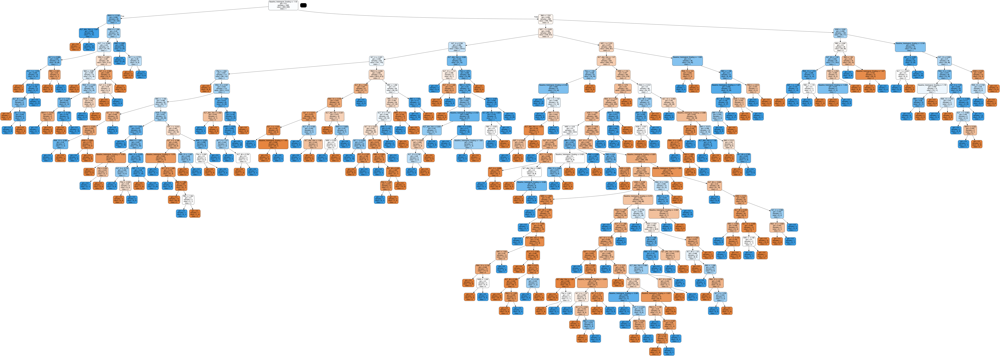

In [119]:
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

labels = X_train_resampled_best.columns
# Select one of the trees from the random forest
tree = best_rf.estimators_[0]  # Change the index if you want a different tree

# Export the selected tree to DOT format
dot_data = export_graphviz(tree, feature_names=labels, class_names=["0", "1"], filled=True, rounded=True)

# Create a graph from DOT data
graph = pydotplus.graph_from_dot_data(dot_data)

# Display the decision tree
Image(graph.create_png())

In [120]:
best_xgb = XGBClassifier(random_state=42)
best_xgb.fit(X_train_resampled_best, y_train_resampled)
print('Train Score:', best_xgb.score(X_train_resampled_best, y_train_resampled))
print('Test Score:', best_xgb.score(X_test_best, y_test))

Train Score: 1.0
Test Score: 0.7220216606498195


In [121]:
best_gb = GradientBoostingClassifier(random_state=42)
best_gb.fit(X_train_resampled_best, y_train_resampled)
print('Train Score:', best_gb.score(X_train_resampled_best, y_train_resampled))
print('Test Score:', best_gb.score(X_test_best, y_test))

Train Score: 0.902744630071599
Test Score: 0.6714801444043321


In [122]:
best_ada = AdaBoostClassifier(random_state=42)
best_ada.fit(X_train_resampled_best, y_train_resampled)
print('Train Score:', best_ada.score(X_train_resampled_best, y_train_resampled))
print('Test Score:', best_ada.score(X_test_best, y_test))

Train Score: 0.7541766109785203
Test Score: 0.5342960288808665


In [123]:
best_bag = BaggingClassifier(random_state=42)
best_bag.fit(X_train_resampled_best, y_train_resampled)
print('Train Score:', best_bag.score(X_train_resampled_best, y_train_resampled))
print('Test Score:', best_bag.score(X_test_best, y_test))

Train Score: 0.997016706443914
Test Score: 0.5667870036101083


In [124]:
best_dt = DecisionTreeClassifier(random_state=42)
best_dt.fit(X_train_resampled_best, y_train_resampled)
print('Train Score:', best_dt.score(X_train_resampled_best, y_train_resampled))
print('Test Score:', best_dt.score(X_test_best, y_test))

Train Score: 1.0
Test Score: 0.592057761732852


In [125]:
scorecard_best = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1_score', 'Train_Accuracy', 'Test_Accuracy'])

def model_accuracy(model_name, classifier, X_train, y_train, X_test, y_test):
    
    # training data 
    model = classifier.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    # testing data
    y_test_pred = model.predict(X_test)
    
    Train_accuracy = model.score(X_train, y_train)
    Test_accuracy = model.score(X_test, y_test)
    
    global scorecard_best
    scorecard_best = pd.concat([scorecard_best, pd.DataFrame({'Model': [model_name],
                                                    'Precision': [precision_score(y_test, y_test_pred, average='weighted')],
                                                    'Recall': [recall_score(y_test, y_test_pred, average='weighted')],
                                                    'F1_score': [f1_score(y_test, y_test_pred, average='weighted')],
                                                    'Train_Accuracy': [Train_accuracy],
                                                    'Test_Accuracy': [Test_accuracy]})], ignore_index=True)

In [126]:
model_accuracy('Random Forest', best_rf, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Decision tree', best_dt, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Gradient Boost', best_gb, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('XGB Classifier', best_xgb, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Ada Boost Forest', best_ada, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Bagging Classifier', best_bag, X_train_resampled_best, y_train_resampled, X_test_best, y_test)

In [127]:
scorecard_best

,Model,Precision,Recall,F1_score,Train_Accuracy,Test_Accuracy
0,Random Forest,0.617256,0.664260,0.637514,1.000000,0.664260
1,Decision tree,0.621306,0.592058,0.605354,1.000000,0.592058
2,Gradient Boost,0.635344,0.671480,0.650938,0.902745,0.671480
3,XGB Classifier,0.673451,0.722022,0.688873,1.000000,0.722022
4,Ada Boost Forest,0.592595,0.534296,0.559056,0.754177,0.534296
5,Bagging Classifier,0.610275,0.566787,0.585817,0.997017,0.566787


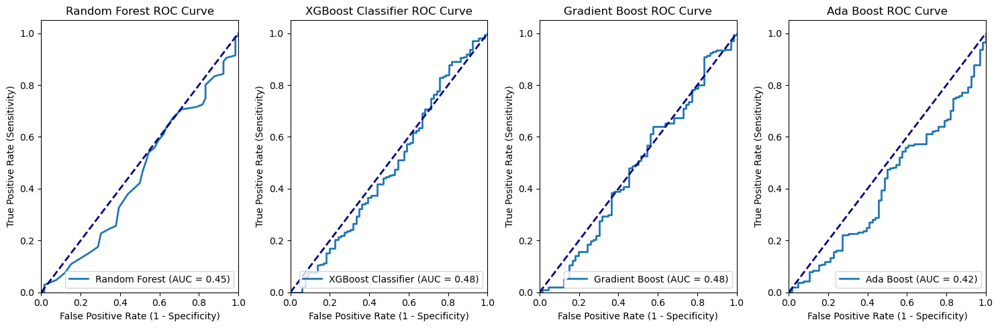

In [128]:
models = {'Random Forest': best_rf,
         'XGBoost Classifier': best_xgb,
         'Gradient Boost': best_gb,
         'Ada Boost': best_ada}

plot_roc_curves_subplots(models, X_test_best, y_test)

In [129]:
# Even after considering only the best features, there is no chnage in the ROC scores.

In [130]:
def plot_confusion_matrices_best(models, model_names):
    num_models = len(models)
    fig, axes = plt.subplots(2, num_models // 2 + num_models % 2, figsize=(15, 12))

    for i, (model, name) in enumerate(zip(models, model_names)):
        ax = axes[i // 2, i % (num_models // 2 + num_models % 2)]  # Select the subplot
        y_pred = model.predict(X_test_best)
        cm = confusion_matrix(y_test, y_pred)

        conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted:1'], index=['Actual:0', 'Actual:1'])

        sns.heatmap(conf_matrix, annot=True, fmt='d', cbar=False, linewidths=0.1, annot_kws={'size': 25}, ax=ax)
        ax.set_title(name)
        ax.set_xlabel('Predicted label')
        ax.set_ylabel('True label')
        ax.tick_params(axis='both', which='major', labelsize=12)

        # Print classification report
        report = classification_report(y_test, y_pred)
        print(f"Classification Report for {name}:")
        print(report)

    plt.tight_layout()
    plt.show()

Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.19      0.12      0.15        66
           1       0.75      0.83      0.79       211

    accuracy                           0.66       277
   macro avg       0.47      0.48      0.47       277
weighted avg       0.62      0.66      0.64       277

Classification Report for XGB Classifier:
              precision    recall  f1-score   support

           0       0.34      0.18      0.24        66
           1       0.78      0.89      0.83       211

    accuracy                           0.72       277
   macro avg       0.56      0.54      0.53       277
weighted avg       0.67      0.72      0.69       277

Classification Report for Gradient Boost:
              precision    recall  f1-score   support

           0       0.23      0.17      0.19        66
           1       0.76      0.83      0.79       211

    accuracy                           0.67       277
   

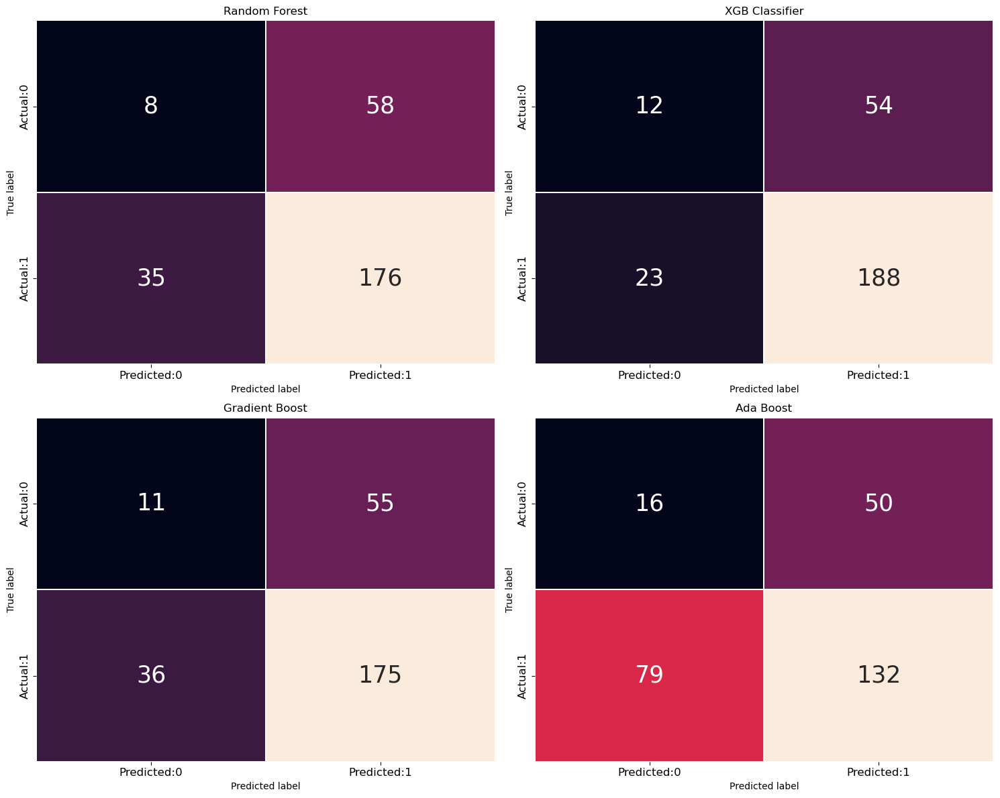

In [131]:
models = [best_rf, best_xgb, best_gb, best_ada]
model_names = ['Random Forest', 'XGB Classifier', 'Gradient Boost', 'Ada Boost']
plot_confusion_matrices_best(models, model_names)

`Inference:`

From the matrices, we can see that the Ada Boost model has the highest number of true negatives (correctly predicted negatives) but also the highest number of false negatives (positives incorrectly labeled as negatives), which could be a problem if the positive class is of high importance (such as a disease being present). The Random Forest and XGB Classifier have a better balance but still have a relatively high number of false positives.

In [132]:
# Still many misclassifications in the data.

`Inference:`
- Even after selecting the best parameters and building the model, we are unable to increase the scores for class label 0.
- Now what we can do is applying PCA on the data.
- After that lets try to tune the model using GridSearchCv. 

### PCA

In [133]:
X

,Age,BMI,WBC,RBC,HGB,Plat,AST_1,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF,Baseline_histological_Grading,Gender_Female,Fever_Present,Nausea/Vomting_Present,Headache_Present,Fatigue_Present,Jaundice_Present,Diarrhea_Present,Epigastric_pain_Present
0,1.102814,1.568525,-0.040636,-0.500596,0.824497,-1.191726,0.624437,0.003232,-1.184223,0.978295,-0.103412,-2.960181,-2.999471,-4.021808,0.181960,0.092882,-0.001962,-1.087692,-1.088823,0.805050,0,1,0,0,1,1,0,1
1,-0.036355,0.096039,1.712476,0.021071,-1.510734,-0.747305,0.316553,1.508243,0.437185,-0.326634,1.118124,-0.989700,1.501857,1.493666,-1.555454,-0.171903,1.221053,0.185824,-0.972681,-1.432396,0,0,1,1,1,1,0,0
2,1.216730,1.077696,-1.257991,0.574935,-0.343119,-0.176017,1.163233,-1.347418,0.437185,0.901534,1.232643,-2.960181,-2.999471,-4.021808,-0.055972,0.166905,-1.012273,1.695069,0.999427,-1.432396,0,1,1,1,0,0,1,0
3,0.305396,1.077696,-0.391183,1.075870,-1.510734,-0.306623,-1.530748,-0.768568,0.965086,-0.134733,0.163799,-1.330745,-0.252898,-0.061981,1.274675,-0.416795,1.040971,1.727277,1.087139,0.059234,1,0,1,0,0,1,1,0
4,1.444564,0.832282,-1.451824,0.532143,-0.926927,0.756456,0.624437,0.775032,-0.618616,-1.362901,1.385335,0.412373,0.243011,-0.486248,0.196318,0.380636,12.069419,0.193923,-0.181303,0.307840,0,0,0,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1380,-0.264188,0.096039,-0.183479,1.545332,1.408305,1.139016,1.509602,-0.961518,-0.203837,0.863154,1.652546,-0.762337,-1.511744,1.635088,-0.574200,-1.504642,-1.012273,-1.087692,-1.088823,1.302260,0,0,1,1,0,0,1,0
1381,0.988897,1.323110,-0.497285,0.620454,-1.510734,-1.097762,1.740514,0.697852,-0.694030,0.594492,0.927259,0.526054,-0.748807,1.069398,-0.309697,-1.236759,0.366648,-0.809510,-0.205921,0.059234,0,0,1,1,0,0,0,0
1382,-0.492022,-0.640203,-0.982427,-0.866734,0.824497,-0.773426,-0.838010,0.350542,1.492986,-0.863957,1.232643,0.147116,-1.702479,-1.334782,0.061369,-0.077694,1.813706,0.211971,-0.489235,-0.935186,0,1,1,0,0,1,0,0
1383,0.647146,0.096039,-0.103622,-0.520285,-1.510734,1.226379,-0.491641,0.504902,0.776550,-0.365014,-1.401293,-1.330745,-0.100311,1.352243,-1.274928,-1.448806,0.795717,-1.078409,1.512293,1.302260,0,1,0,0,1,1,1,0


In [134]:
X

,Age,BMI,WBC,RBC,HGB,Plat,AST_1,ALT_1,ALT_4,ALT_12,ALT_24,ALT_36,ALT_48,ALT_after_24w,RNA_Base,RNA 4,RNA_12,RNA_EOT,RNA_EF,Baseline_histological_Grading,Gender_Female,Fever_Present,Nausea/Vomting_Present,Headache_Present,Fatigue_Present,Jaundice_Present,Diarrhea_Present,Epigastric_pain_Present
0,1.102814,1.568525,-0.040636,-0.500596,0.824497,-1.191726,0.624437,0.003232,-1.184223,0.978295,-0.103412,-2.960181,-2.999471,-4.021808,0.181960,0.092882,-0.001962,-1.087692,-1.088823,0.805050,0,1,0,0,1,1,0,1
1,-0.036355,0.096039,1.712476,0.021071,-1.510734,-0.747305,0.316553,1.508243,0.437185,-0.326634,1.118124,-0.989700,1.501857,1.493666,-1.555454,-0.171903,1.221053,0.185824,-0.972681,-1.432396,0,0,1,1,1,1,0,0
2,1.216730,1.077696,-1.257991,0.574935,-0.343119,-0.176017,1.163233,-1.347418,0.437185,0.901534,1.232643,-2.960181,-2.999471,-4.021808,-0.055972,0.166905,-1.012273,1.695069,0.999427,-1.432396,0,1,1,1,0,0,1,0
3,0.305396,1.077696,-0.391183,1.075870,-1.510734,-0.306623,-1.530748,-0.768568,0.965086,-0.134733,0.163799,-1.330745,-0.252898,-0.061981,1.274675,-0.416795,1.040971,1.727277,1.087139,0.059234,1,0,1,0,0,1,1,0
4,1.444564,0.832282,-1.451824,0.532143,-0.926927,0.756456,0.624437,0.775032,-0.618616,-1.362901,1.385335,0.412373,0.243011,-0.486248,0.196318,0.380636,12.069419,0.193923,-0.181303,0.307840,0,0,0,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1380,-0.264188,0.096039,-0.183479,1.545332,1.408305,1.139016,1.509602,-0.961518,-0.203837,0.863154,1.652546,-0.762337,-1.511744,1.635088,-0.574200,-1.504642,-1.012273,-1.087692,-1.088823,1.302260,0,0,1,1,0,0,1,0
1381,0.988897,1.323110,-0.497285,0.620454,-1.510734,-1.097762,1.740514,0.697852,-0.694030,0.594492,0.927259,0.526054,-0.748807,1.069398,-0.309697,-1.236759,0.366648,-0.809510,-0.205921,0.059234,0,0,1,1,0,0,0,0
1382,-0.492022,-0.640203,-0.982427,-0.866734,0.824497,-0.773426,-0.838010,0.350542,1.492986,-0.863957,1.232643,0.147116,-1.702479,-1.334782,0.061369,-0.077694,1.813706,0.211971,-0.489235,-0.935186,0,1,1,0,0,1,0,0
1383,0.647146,0.096039,-0.103622,-0.520285,-1.510734,1.226379,-0.491641,0.504902,0.776550,-0.365014,-1.401293,-1.330745,-0.100311,1.352243,-1.274928,-1.448806,0.795717,-1.078409,1.512293,1.302260,0,1,0,0,1,1,1,0


In [135]:
y.value_counts()

Baselinehistological_staging
1                               1049
0                                336
dtype: int64

In [136]:
y_test

,Baselinehistological_staging
1128,1
237,1
163,1
739,1
51,1
...,...
289,1
693,0
462,1
945,0


In [137]:
from sklearn.decomposition import PCA

In [138]:
# Apply PCA
pca = PCA()
pca.fit(X_train_resampled)

# Transform the input features into principal components
transformed_input_features = pca.transform(X_train_resampled)

# Convert to DataFrame for easier analysis
transformed_input_df = pd.DataFrame(transformed_input_features, columns=[f'PC{i+1}' for i in range(transformed_input_features.shape[1])])
(transformed_input_df)

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,PC28
0,-0.512894,0.363167,0.528665,-0.107794,-2.751595,0.684423,-1.376738,-0.969044,-0.912580,-1.479272,-0.809141,0.163485,-0.743673,-0.832576,0.388480,-0.531274,-0.265118,-0.816547,-0.249123,0.161935,0.874167,0.446319,0.021890,0.921959,-0.470751,-0.220301,-0.076920,0.682116
1,0.349356,0.407032,-0.002261,-1.128211,0.746810,-0.573469,1.568650,-0.996454,1.715149,0.918209,0.246525,1.870851,-1.154659,-0.361563,-1.096050,0.373493,0.246675,-1.153165,0.419768,-0.233395,0.353357,-0.130424,-0.038575,-0.145608,0.276048,-0.229663,0.811246,0.962338
2,0.394361,-0.200305,-0.245252,-2.287128,1.907831,-0.122069,0.192037,-0.348645,1.003978,0.720648,0.487711,-0.472944,-0.564635,-0.677490,-1.003316,-0.317741,-0.583623,0.147379,-1.271094,-0.657572,-0.171570,0.596865,0.526026,0.706808,0.420386,-0.369545,0.167577,0.389217
3,1.540657,-0.264104,-1.425154,1.222490,0.513234,0.352390,0.218756,-2.175157,0.095825,0.215948,-1.137878,-0.895350,0.702022,0.191406,0.275330,-0.680401,0.935620,-0.196822,-0.127791,-0.623063,0.352479,-0.238346,-0.751535,0.794853,0.445292,0.503904,0.298568,0.614909
4,-1.668652,-0.326257,-0.766755,-0.030775,0.393400,-1.730519,0.159528,-1.494995,-1.008122,1.008887,1.107880,-0.525771,-1.272224,0.627110,1.218628,-0.258540,-0.514105,-0.333745,-0.242255,0.115048,-0.246012,0.658310,0.755437,0.323289,-0.808611,-0.055152,-0.076897,-0.295254
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1671,-2.057519,0.293029,-1.342482,-0.507406,0.622588,-0.304565,2.040121,0.293442,0.654439,-0.024536,0.254020,0.098335,-0.490877,0.070538,0.467267,-0.791573,-0.167068,-0.319650,0.151737,0.144926,-0.570323,0.160582,-0.263667,-0.271074,0.650293,-0.320874,-0.949477,0.136480
1672,0.143964,1.595771,-0.539714,-0.082254,1.212253,0.274206,-0.673083,0.784025,-1.515760,-1.286339,-1.041321,-0.540272,0.346295,2.026378,-0.296542,-0.074097,-0.839197,-0.943399,-0.602198,-0.508095,-0.433057,0.303338,0.313106,-0.636316,0.069374,0.096914,0.765375,-0.052704
1673,-0.974753,-0.521031,0.650292,-2.306320,1.355926,-1.110609,2.820743,-1.608309,0.114390,0.160099,1.114990,0.898786,-0.136209,-0.244129,-0.548040,0.080812,-0.107917,0.666013,-0.400447,-0.656789,-0.548707,0.137607,-0.159613,-0.020186,0.029988,0.927905,0.369148,-0.571378
1674,0.337226,-1.878238,0.078693,0.496773,-1.802369,0.165775,-0.765197,1.228214,-0.898948,-1.570331,-0.374332,-0.925964,0.038426,0.830645,0.738915,0.416218,0.607519,0.700211,-0.810954,-0.388890,-0.599634,-1.117705,-0.330722,0.442994,-0.122757,-0.050351,0.153399,0.356043


In [139]:
explained_variance_ratio = pca.explained_variance_ratio_
# Calculate the cumulative explained variance ratio up to the first 5 components
cumulative_explained_variance_ratio = explained_variance_ratio.cumsum()

# Display the cumulative explained variance ratio
print("Cumulative explained variance ratio up to the first 5 principal components:")
print(cumulative_explained_variance_ratio[:8])

Cumulative explained variance ratio up to the first 5 principal components:
[0.09069011 0.14929823 0.20357573 0.25610917 0.30800608 0.35773926
 0.40668197 0.45342738]


In [140]:
cumulative_explained_variance_ratio[:20]

array([0.09069011, 0.14929823, 0.20357573, 0.25610917, 0.30800608,
       0.35773926, 0.40668197, 0.45342738, 0.49865297, 0.54298335,
       0.58693661, 0.6302271 , 0.67089858, 0.71151257, 0.75002196,
       0.78745521, 0.82330016, 0.85821168, 0.88568532, 0.90915252])

In [141]:
# lets consider the first 20 compoments since it contributes to the 90% of the data.

In [142]:
X_pca = transformed_input_df.iloc[:, :20]
X_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
0,-0.512894,0.363167,0.528665,-0.107794,-2.751595,0.684423,-1.376738,-0.969044,-0.912580,-1.479272,-0.809141,0.163485,-0.743673,-0.832576,0.388480,-0.531274,-0.265118,-0.816547,-0.249123,0.161935
1,0.349356,0.407032,-0.002261,-1.128211,0.746810,-0.573469,1.568650,-0.996454,1.715149,0.918209,0.246525,1.870851,-1.154659,-0.361563,-1.096050,0.373493,0.246675,-1.153165,0.419768,-0.233395
2,0.394361,-0.200305,-0.245252,-2.287128,1.907831,-0.122069,0.192037,-0.348645,1.003978,0.720648,0.487711,-0.472944,-0.564635,-0.677490,-1.003316,-0.317741,-0.583623,0.147379,-1.271094,-0.657572
3,1.540657,-0.264104,-1.425154,1.222490,0.513234,0.352390,0.218756,-2.175157,0.095825,0.215948,-1.137878,-0.895350,0.702022,0.191406,0.275330,-0.680401,0.935620,-0.196822,-0.127791,-0.623063
4,-1.668652,-0.326257,-0.766755,-0.030775,0.393400,-1.730519,0.159528,-1.494995,-1.008122,1.008887,1.107880,-0.525771,-1.272224,0.627110,1.218628,-0.258540,-0.514105,-0.333745,-0.242255,0.115048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1671,-2.057519,0.293029,-1.342482,-0.507406,0.622588,-0.304565,2.040121,0.293442,0.654439,-0.024536,0.254020,0.098335,-0.490877,0.070538,0.467267,-0.791573,-0.167068,-0.319650,0.151737,0.144926
1672,0.143964,1.595771,-0.539714,-0.082254,1.212253,0.274206,-0.673083,0.784025,-1.515760,-1.286339,-1.041321,-0.540272,0.346295,2.026378,-0.296542,-0.074097,-0.839197,-0.943399,-0.602198,-0.508095
1673,-0.974753,-0.521031,0.650292,-2.306320,1.355926,-1.110609,2.820743,-1.608309,0.114390,0.160099,1.114990,0.898786,-0.136209,-0.244129,-0.548040,0.080812,-0.107917,0.666013,-0.400447,-0.656789
1674,0.337226,-1.878238,0.078693,0.496773,-1.802369,0.165775,-0.765197,1.228214,-0.898948,-1.570331,-0.374332,-0.925964,0.038426,0.830645,0.738915,0.416218,0.607519,0.700211,-0.810954,-0.388890


In [143]:
y_train_resampled

,Baselinehistological_staging
0,0
1,0
2,0
3,0
4,1
...,...
1671,0
1672,0
1673,0
1674,0


In [144]:
X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(X_pca, y_train_resampled, test_size = 0.2, random_state = 42)
print('X_train', X_train_pca.shape)
print('y_train', y_train_pca.shape)
print('X_test', X_test_pca.shape)
print('y_test', y_test_pca.shape)

X_train (1340, 20)
y_train (1340, 1)
X_test (336, 20)
y_test (336, 1)


### Random Forest

In [145]:
pca_rf = RandomForestClassifier(random_state=42)
pca_rf.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_rf.score(X_train_pca, y_train_pca))
print('Test Score:', pca_rf.score(X_test_pca, y_test_pca))

Train Score: 1.0
Test Score: 0.8392857142857143


In [146]:
labels = X_train_pca.columns

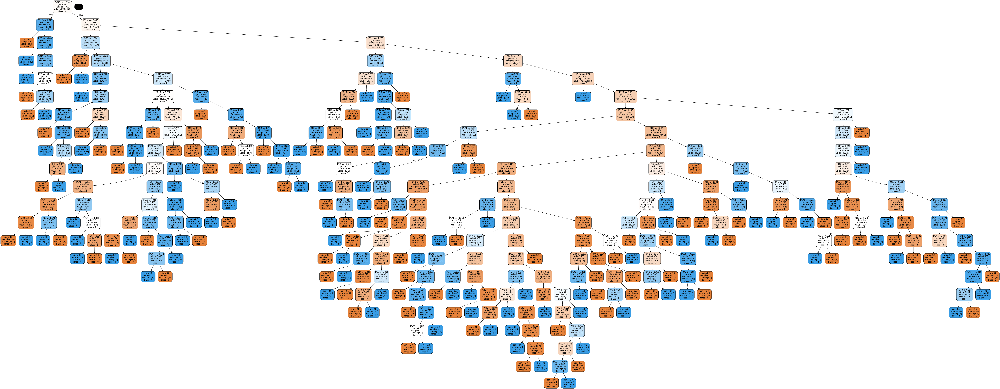

In [147]:
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

# Select one of the trees from the random forest
tree = pca_rf.estimators_[0]  # Change the index if you want a different tree

# Export the selected tree to DOT format
dot_data = export_graphviz(tree, feature_names=labels, class_names=["0", "1"], filled=True, rounded=True)

# Create a graph from DOT data
graph = pydotplus.graph_from_dot_data(dot_data)

# Display the decision tree
Image(graph.create_png())

### XGBClassifier

In [148]:
pca_xgb = XGBClassifier(random_state=42)
pca_xgb.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_xgb.score(X_train_pca, y_train_pca))
print('Test Score:', pca_xgb.score(X_test_pca, y_test_pca))

Train Score: 1.0
Test Score: 0.8095238095238095


### DecisionTreeClassifier

In [149]:
pca_dt = DecisionTreeClassifier(random_state=42)
pca_dt.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_dt.score(X_train_pca, y_train_pca))
print('Test Score:', pca_dt.score(X_test_pca, y_test_pca))

Train Score: 1.0
Test Score: 0.7053571428571429


### BaggingClassifier

In [150]:
pca_bag = BaggingClassifier(random_state=42)
pca_bag.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_bag.score(X_train_pca, y_train_pca))
print('Test Score:', pca_bag.score(X_test_pca, y_test_pca))

Train Score: 0.994776119402985
Test Score: 0.7440476190476191


### GradientBoostingClassifier

In [151]:
pca_gb = GradientBoostingClassifier(random_state=42)
pca_gb.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_gb.score(X_train_pca, y_train_pca))
print('Test Score:', pca_gb.score(X_test_pca, y_test_pca))

Train Score: 0.9223880597014925
Test Score: 0.6964285714285714


### AdaBoostClassifier

In [152]:
pca_ada = AdaBoostClassifier(random_state=42)
pca_ada.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_ada.score(X_train_pca, y_train_pca))
print('Test Score:', pca_ada.score(X_test_pca, y_test_pca))

Train Score: 0.7582089552238805
Test Score: 0.6071428571428571


### KNeighborsClassifier

In [153]:
pca_knn = KNeighborsClassifier()
pca_knn.fit(X_train_pca, y_train_pca)
print('Train Score:', pca_knn.score(X_train_pca, y_train_pca))
print('Test Score:', pca_knn.score(X_test_pca, y_test_pca))

Train Score: 0.755223880597015
Test Score: 0.6875


### Scorecard

In [154]:
scorecard_pca = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1_score', 'Train_Accuracy', 'Test_Accuracy'])

def model_accuracy(model_name, classifier, X_train, y_train, X_test, y_test):
    
    # training data 
    model = classifier.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    # testing data
    y_test_pred = model.predict(X_test)
    
    Train_accuracy = model.score(X_train, y_train)
    Test_accuracy = model.score(X_test, y_test)
    
    global scorecard_pca
    scorecard_pca = pd.concat([scorecard_pca, pd.DataFrame({'Model': [model_name],
                                                    'Precision': [precision_score(y_test, y_test_pred, average='weighted')],
                                                    'Recall': [recall_score(y_test, y_test_pred, average='weighted')],
                                                    'F1_score': [f1_score(y_test, y_test_pred, average='weighted')],
                                                    'Train_Accuracy': [Train_accuracy],
                                                    'Test_Accuracy': [Test_accuracy]})], ignore_index=True)

In [155]:
model_accuracy('Random Forest', pca_rf, X_train_pca, y_train_pca, X_test_pca, y_test_pca)
model_accuracy('Decision tree', pca_dt, X_train_pca, y_train_pca, X_test_pca, y_test_pca)
model_accuracy('Gradient Boost', pca_gb, X_train_pca, y_train_pca, X_test_pca, y_test_pca)
model_accuracy('XGB Classifier', pca_xgb, X_train_pca, y_train_pca, X_test_pca, y_test_pca)
model_accuracy('Ada Boost Forest', pca_ada, X_train_pca, y_train_pca, X_test_pca, y_test_pca)
model_accuracy('Bagging Classifier', pca_bag, X_train_pca, y_train_pca, X_test_pca, y_test_pca)

In [156]:
scorecard_pca

,Model,Precision,Recall,F1_score,Train_Accuracy,Test_Accuracy
0,Random Forest,0.839685,0.839286,0.839217,1.000000,0.839286
1,Decision tree,0.705354,0.705357,0.705349,1.000000,0.705357
2,Gradient Boost,0.700264,0.696429,0.694741,0.922388,0.696429
3,XGB Classifier,0.811031,0.809524,0.809240,1.000000,0.809524
4,Ada Boost Forest,0.607130,0.607143,0.607115,0.758209,0.607143
5,Bagging Classifier,0.750773,0.744048,0.742128,0.994776,0.744048


`Inference:`

- The Random Forest and XGB Classifier show a perfect training accuracy of 1.000000, indicating they may have overfitted the training data. Their test accuracies are good but a perfect score on training data warrants a closer look to confirm the models' ability to generalize.

- The Decision Tree and Gradient Boost models show reasonable performance, though not as high as Random Forest or XGB Classifier. Ada Boost Forest has the lowest precision, recall, F1 score, and test accuracy, indicating it may be the least effective model after applying PCA in this scenario.

- Bagging Classifier presents a good balance between precision and recall and has a high training accuracy but without the perfect fit seen in Random Forest and XGB Classifier, suggesting better generalization.

Overall, applying PCA seems to have helped some models more than others. The Random Forest and XGB Classifier might be considered the best performing models based on these results, but the potential overfitting indicated by their perfect training accuracy could be a point of concern.

### Confusion Matrix

In [157]:
def plot_confusion_matrices_pca(models, model_names):
    num_models = len(models)
    fig, axes = plt.subplots(2, num_models // 2 + num_models % 2, figsize=(15, 12))

    for i, (model, name) in enumerate(zip(models, model_names)):
        ax = axes[i // 2, i % (num_models // 2 + num_models % 2)]  # Select the subplot
        y_pred = model.predict(X_test_pca)
        cm = confusion_matrix(y_test_pca, y_pred)

        conf_matrix = pd.DataFrame(data=cm, columns=['Predicted:0', 'Predicted:1'], index=['Actual:0', 'Actual:1'])

        sns.heatmap(conf_matrix, annot=True, fmt='d', cbar=False, linewidths=0.1, annot_kws={'size': 25}, ax=ax)
        ax.set_title(name)
        ax.set_xlabel('Predicted label')
        ax.set_ylabel('True label')
        ax.tick_params(axis='both', which='major', labelsize=12)

        # Print classification report
        report = classification_report(y_test_pca, y_pred)
        print(f"Classification Report for {name}:")
        print(report)

    plt.tight_layout()
    plt.show()

Classification Report for Random Forest:
              precision    recall  f1-score   support

           0       0.83      0.86      0.84       169
           1       0.85      0.82      0.84       167

    accuracy                           0.84       336
   macro avg       0.84      0.84      0.84       336
weighted avg       0.84      0.84      0.84       336

Classification Report for XGB Classifier:
              precision    recall  f1-score   support

           0       0.79      0.85      0.82       169
           1       0.83      0.77      0.80       167

    accuracy                           0.81       336
   macro avg       0.81      0.81      0.81       336
weighted avg       0.81      0.81      0.81       336

Classification Report for Gradient Boost:
              precision    recall  f1-score   support

           0       0.67      0.77      0.72       169
           1       0.73      0.62      0.67       167

    accuracy                           0.70       336
   

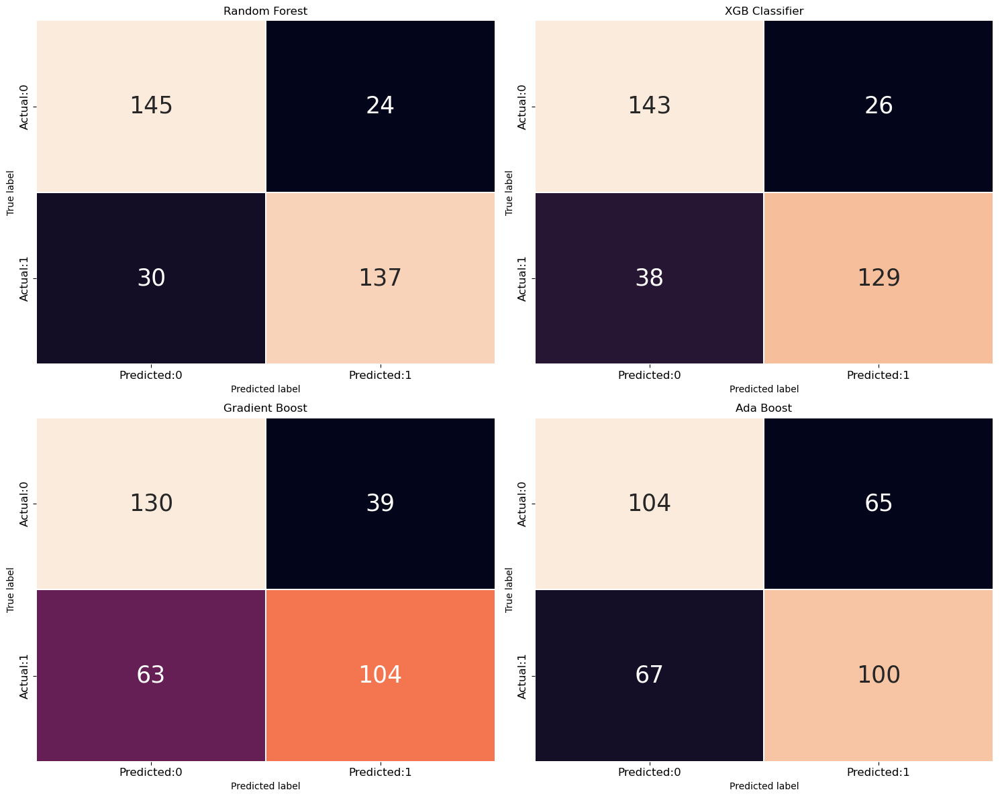

In [158]:
models = [pca_rf, pca_xgb, pca_gb, pca_ada]
model_names = ['Random Forest', 'XGB Classifier', 'Gradient Boost', 'Ada Boost']
plot_confusion_matrices_pca(models, model_names)

In [159]:
# Finally the model started working well after applying PCA to the data.

`Inference:`
    
- After applying PCA, the '0' class labels are predicted correctly.
- There are few misclassifications in the dataset but still the model is performing good.
- We have achieved an accuracy of 84% for Random Forest which is the highest.
- Models like Random Forest and XGBoost Classifier show relatively high true positive and true negative rates, suggesting good classification performance.
- The Gradient Boost and Ada Boost models have lower true positive rates compared to the Random Forest and XGBoost Classifier.

In [160]:
# Now the step which is left behind is Hyperparameter tuning.

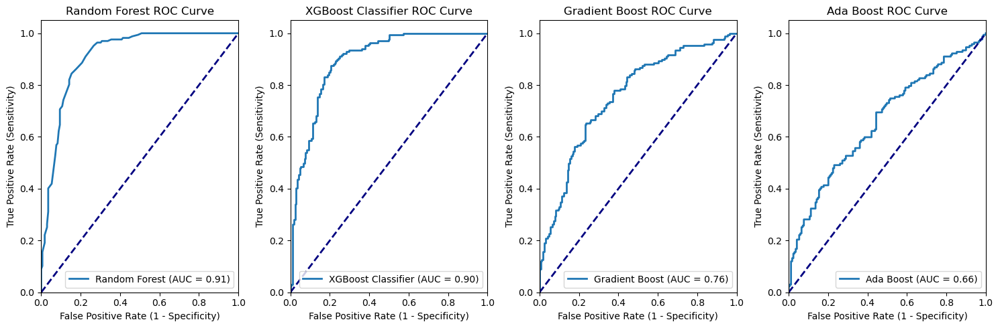

In [161]:
models = {'Random Forest': pca_rf,
         'XGBoost Classifier': pca_xgb,
         'Gradient Boost': pca_gb,
         'Ada Boost': pca_ada}

plot_roc_curves_subplots(models, X_test_pca, y_test_pca)

`Inference:`

- The Random Forest and XGBoost Classifier models have high AUC scores (0.91 and 0.90, respectively), indicating excellent predictive performance.
- The Gradient Boost's AUC is 0.76, which is decent, showing good classification capability.
- The Ada Boost model has the lowest AUC score (0.66), which is still fair but suggests the model's predictive performance is not as strong as the others.

### Hyperparameter Tuning

- Lets apply Hyperparameter tuning on the resampled data, since applying hyperparameter tuning on the imbalance data doesn't make any sense.

### Tuning on all the features

### Tuned Random Forest

In [162]:
rf = RandomForestClassifier(random_state=53)

hyp_parameters = {
    'n_estimators': [20, 50, 100],
    'criterion': ['gini', 'entropy'],
    'max_depth': [2, 3, 5, 6],
    'min_samples_split': [2, 3, 4, 5],
    'min_samples_leaf': [1, 3, 5],
    'max_leaf_nodes': [2, 3, 4]
}

kf = KFold(n_splits=5, shuffle=True, random_state=10)
grid_rf = GridSearchCV(estimator=rf, param_grid=hyp_parameters, cv=kf, scoring='f1_weighted')
grid_rf.fit(X_train_resampled, y_train_resampled)

# Print results
print("Best parameters found: ", grid_rf.best_params_)
print("Best cross-validation score: ", grid_rf.best_score_)
print("Train set score with best parameters: ", grid_rf.score(X_train_resampled, y_train_resampled))
print("Test set score with best parameters: ", grid_rf.score(X_test, y_test))

Best parameters found:  {'criterion': 'entropy', 'max_depth': 3, 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Best cross-validation score:  0.6953806873073309
Train set score with best parameters:  0.713627012814307
Test set score with best parameters:  0.649641531499466


### Tuned Decision Tree

In [163]:
dt = DecisionTreeClassifier(random_state=53)

hyp_parameters = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [2, 3, 5, 6, 10, 15],
    'min_samples_split': [2, 3, 4, 5],
    'min_samples_leaf': [1, 3, 5],
    'max_leaf_nodes': [2, 3, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

kf = KFold(n_splits=5, shuffle=True, random_state=10)
grid_dt = GridSearchCV(estimator=dt, param_grid=hyp_parameters, cv=kf, scoring='f1_weighted')
grid_dt.fit(X_train_resampled, y_train_resampled)

print("Best parameters found: ", grid_dt.best_params_)
print("Best cross-validation score: ", grid_dt.best_score_)
print("Train set score with best parameters: ", grid_dt.score(X_train_resampled, y_train_resampled))
print("Test set score with best parameters: ", grid_dt.score(X_test, y_test))

Best parameters found:  {'criterion': 'gini', 'max_depth': 3, 'max_features': 'sqrt', 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best cross-validation score:  0.621242153788742
Train set score with best parameters:  0.6301110404732808
Test set score with best parameters:  0.6659514098182532


### Tuned Bagging Classifier

In [164]:
bag = BaggingClassifier(n_jobs=-1, random_state = 53)

hyp_parameters = {'n_estimators':[10, 20, 40],
                  'max_samples':[1,2,3],
                  'max_features':[1,2,3]}

Kf = KFold(n_splits=3, shuffle=True, random_state=10)
grid_bag = GridSearchCV(estimator=bag, param_grid=hyp_parameters, cv=Kf, scoring='f1_weighted')
grid_bag.fit(X_train_resampled, y_train_resampled)

print('The best parameters from KNeighbors Classifier are:\n ', grid_bag.best_params_)
print("Best cross-validation score: ", grid_bag.best_score_)
print("Train set score with best parameters: ", grid_bag.score(X_train_resampled, y_train_resampled))
print("Test set score with best parameters: ", grid_bag.score(X_test, y_test))

The best parameters from KNeighbors Classifier are:
  {'max_features': 2, 'max_samples': 3, 'n_estimators': 40}
Best cross-validation score:  0.523058190568918
Train set score with best parameters:  0.5436853395380066
Test set score with best parameters:  0.5907497155288898


### Tuned AdaBoost

In [165]:
Ada = AdaBoostClassifier(random_state=53)

hyp_parameters = {'n_estimators':[30,50,80,100],
                 'learning_rate':[0.5,1,1.5,2]}

kf = KFold(n_splits=5,shuffle=True,random_state=10)

grid_Ada = GridSearchCV(estimator=Ada,param_grid=hyp_parameters,cv=kf,scoring='f1_weighted')

grid_Ada.fit(X_train_resampled, y_train_resampled)

print("Best parameters found: ", grid_Ada.best_params_)
print("Best cross-validation score: ", grid_Ada.best_score_)
print("Train set score with best parameters: ", grid_Ada.score(X_train_resampled, y_train_resampled))
print("Test set score with best parameters: ", grid_Ada.score(X_test, y_test))

Best parameters found:  {'learning_rate': 1, 'n_estimators': 80}
Best cross-validation score:  0.7148090528393688
Train set score with best parameters:  0.7834091095995018
Test set score with best parameters:  0.6571799420738584


### Tuned Gradient Boost

In [166]:
from sklearn.pipeline import make_pipeline
base_estimators = [RandomForestClassifier(), DecisionTreeClassifier()]
gb = GradientBoostingClassifier(random_state=53)
pipeline = make_pipeline(StandardScaler(), gb)
hyp_parameters = {
    'gradientboostingclassifier__n_estimators': [30, 50, 80, 100],
    'gradientboostingclassifier__learning_rate': [0.5, 1, 1.5, 2]
}
kf = KFold(n_splits=5, shuffle=True, random_state=10)
grid_gb = GridSearchCV(estimator=pipeline, param_grid=hyp_parameters, cv=kf, scoring='f1_weighted')
grid_gb.fit(X_train_resampled, y_train_resampled)

print("Best parameters found: ", grid_gb.best_params_)
print("Best cross-validation score: ", grid_gb.best_score_)
print("Train set score with best parameters: ", grid_gb.score(X_train_resampled, y_train_resampled))
print("Test set score with best parameters: ", grid_gb.score(X_test, y_test))

Best parameters found:  {'gradientboostingclassifier__learning_rate': 0.5, 'gradientboostingclassifier__n_estimators': 100}
Best cross-validation score:  0.7744308715271668
Train set score with best parameters:  0.9982100232291139
Test set score with best parameters:  0.6311879817737198


In [167]:
scorecard_tuned_all_features = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1_score', 'Train_Accuracy', 'Test_Accuracy'])

def model_accuracy(model_name, classifier, X_train, y_train, X_test, y_test):
    
    # training data 
    model = classifier.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    # testing data
    y_test_pred = model.predict(X_test)
    
    Train_accuracy = model.score(X_train, y_train)
    Test_accuracy = model.score(X_test, y_test)
    
    global scorecard_tuned_all_features
    scorecard_tuned_all_features = pd.concat([scorecard_tuned_all_features, pd.DataFrame({'Model': [model_name],
                                                    'Precision': [precision_score(y_test, y_test_pred, average='weighted')],
                                                    'Recall': [recall_score(y_test, y_test_pred, average='weighted')],
                                                    'F1_score': [f1_score(y_test, y_test_pred, average='weighted')],
                                                    'Train_Accuracy': [Train_accuracy],
                                                    'Test_Accuracy': [Test_accuracy]})], ignore_index=True)

In [168]:
model_accuracy('Tuned Random Forest', grid_rf, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Tuned Decision Tree', grid_dt, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Tuned Bagging Classifier', grid_bag, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Tuned AdaBoost Classifier', grid_Ada, X_train_resampled, y_train_resampled, X_test, y_test)
model_accuracy('Tuned GradientBoost Classifier', grid_gb, X_train_resampled, y_train_resampled, X_test, y_test)

In [169]:
scorecard_tuned_all_features

,Model,Precision,Recall,F1_score,Train_Accuracy,Test_Accuracy
0,Tuned Random Forest,0.646074,0.653430,0.649642,0.713627,0.649642
1,Tuned Decision Tree,0.655737,0.678700,0.665951,0.630111,0.665951
2,Tuned Bagging Classifier,0.636887,0.563177,0.590750,0.543685,0.590750
3,Tuned AdaBoost Classifier,0.665703,0.649819,0.657180,0.783409,0.657180
4,Tuned GradientBoost Classifier,0.606356,0.664260,0.631188,0.998210,0.631188


`Inference:`

- The Tuned Decision Tree model has the highest test accuracy and also shows a good balance between precision and recall.
- The Tuned Random Forest and Tuned AdaBoost Classifier show relatively high F1 scores, indicating a good balance between precision and recall. However, their test accuracy is slightly lower than the Decision Tree model.
- The Tuned Bagging Classifier has the lowest test accuracy and F1 score, suggesting it might be the least effective of the tuned models.
- The Tuned GradientBoost Classifier shows a very high training accuracy but a much lower test accuracy, indicating potential overfitting.
- The test accuracies are fairly consistent, but not as high as one might expect from tuned models, indicating there may still be room for improvement, either in further tuning or in feature engineering.

### Tuning only on the important features

### Tuned Random Forest

In [170]:
rf = RandomForestClassifier(random_state=53)

hyp_parameters = {
    'n_estimators': [20, 50, 100],
    'criterion': ['gini', 'entropy'],
    'max_depth': [2, 3, 5, 6],
    'min_samples_split': [2, 3, 4, 5],
    'min_samples_leaf': [1, 3, 5],
    'max_leaf_nodes': [2, 3, 4]
}

kf = KFold(n_splits=5, shuffle=True, random_state=10)
grid_rf = GridSearchCV(estimator=rf, param_grid=hyp_parameters, cv=kf, scoring='f1_weighted')
grid_rf.fit(X_train_resampled_best, y_train_resampled)

# Print results
print("Best parameters found: ", grid_rf.best_params_)
print("Best cross-validation score: ", grid_rf.best_score_)
print("Train set score with best parameters: ", grid_rf.score(X_train_resampled_best, y_train_resampled))
print("Test set score with best parameters: ", grid_rf.score(X_test_best, y_test))

Best parameters found:  {'criterion': 'gini', 'max_depth': 3, 'max_leaf_nodes': 4, 'min_samples_leaf': 5, 'min_samples_split': 2, 'n_estimators': 100}
Best cross-validation score:  0.6386022191206988
Train set score with best parameters:  0.6797412201762887
Test set score with best parameters:  0.5611863884046029


### Tuned Decision Tree

In [171]:
dt = DecisionTreeClassifier(random_state=53)

hyp_parameters = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [2, 3, 5, 6, 10, 15],
    'min_samples_split': [2, 3, 4, 5],
    'min_samples_leaf': [1, 3, 5],
    'max_leaf_nodes': [2, 3, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

kf = KFold(n_splits=5, shuffle=True, random_state=10)
grid_dt = GridSearchCV(estimator=dt, param_grid=hyp_parameters, cv=kf, scoring='f1_weighted')
grid_dt.fit(X_train_resampled_best, y_train_resampled)

print("Best parameters found: ", grid_dt.best_params_)
print("Best cross-validation score: ", grid_dt.best_score_)
print("Train set score with best parameters: ", grid_dt.score(X_train_resampled_best, y_train_resampled))
print("Test set score with best parameters: ", grid_dt.score(X_test_best, y_test))

Best parameters found:  {'criterion': 'entropy', 'max_depth': 3, 'max_features': 'sqrt', 'max_leaf_nodes': 4, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best cross-validation score:  0.5410869568437716
Train set score with best parameters:  0.5970371742378774
Test set score with best parameters:  0.5311476786164051


### Tuned Bagging Classifier

In [172]:
bag = BaggingClassifier(n_jobs=-1, random_state = 53)

hyp_parameters = {'n_estimators':[10, 20, 40],
                  'max_samples':[1,2,3],
                  'max_features':[1,2,3]}

Kf = KFold(n_splits=3, shuffle=True, random_state=10)
grid_bag = GridSearchCV(estimator=bag, param_grid=hyp_parameters, cv=Kf, scoring='f1_weighted')
grid_bag.fit(X_train_resampled_best, y_train_resampled)

print('The best parameters from KNeighbors Classifier are:\n ', grid_bag.best_params_)
print("Best cross-validation score: ", grid_bag.best_score_)
print("Train set score with best parameters: ", grid_bag.score(X_train_resampled_best, y_train_resampled))
print("Test set score with best parameters: ", grid_bag.score(X_test_best, y_test))

The best parameters from KNeighbors Classifier are:
  {'max_features': 1, 'max_samples': 2, 'n_estimators': 20}
Best cross-validation score:  0.5154764857649771
Train set score with best parameters:  0.5139893633986387
Test set score with best parameters:  0.42704718379742934


### Tuned AdaBoost Classifier

In [173]:
Ada = AdaBoostClassifier(random_state=53)

hyp_parameters = {'n_estimators':[30,50,80,100],
                 'learning_rate':[0.5,1,1.5,2]}

kf = KFold(n_splits=5,shuffle=True,random_state=10)

grid_Ada = GridSearchCV(estimator=Ada,param_grid=hyp_parameters,cv=kf,scoring='f1_weighted')

grid_Ada.fit(X_train_resampled_best, y_train_resampled)

print("Best parameters found: ", grid_Ada.best_params_)
print("Best cross-validation score: ", grid_Ada.best_score_)
print("Train set score with best parameters: ", grid_Ada.score(X_train_resampled_best, y_train_resampled))
print("Test set score with best parameters: ", grid_Ada.score(X_test_best, y_test))

Best parameters found:  {'learning_rate': 1.5, 'n_estimators': 100}
Best cross-validation score:  0.7170664243994306
Train set score with best parameters:  0.8057372941954789
Test set score with best parameters:  0.6452909195867761


### Tuned Gradient Boost

In [174]:
from sklearn.pipeline import make_pipeline
base_estimators = [RandomForestClassifier(), DecisionTreeClassifier()]
gb = GradientBoostingClassifier(random_state=53)
pipeline = make_pipeline(StandardScaler(), gb)
hyp_parameters = {
    'gradientboostingclassifier__n_estimators': [30, 50, 80, 100],
    'gradientboostingclassifier__learning_rate': [0.5, 1, 1.5, 2]
}
kf = KFold(n_splits=5, shuffle=True, random_state=10)
grid_gb = GridSearchCV(estimator=pipeline, param_grid=hyp_parameters, cv=kf, scoring='f1_weighted')
grid_gb.fit(X_train_resampled_best, y_train_resampled)

print("Best parameters found: ", grid_gb.best_params_)
print("Best cross-validation score: ", grid_gb.best_score_)
print("Train set score with best parameters: ", grid_gb.score(X_train_resampled_best, y_train_resampled))
print("Test set score with best parameters: ", grid_gb.score(X_test_best, y_test))

Best parameters found:  {'gradientboostingclassifier__learning_rate': 0.5, 'gradientboostingclassifier__n_estimators': 100}
Best cross-validation score:  0.7704532863398897
Train set score with best parameters:  0.9958233756395144
Test set score with best parameters:  0.6485002576833158


In [175]:
scorecard_tuned_imp_features = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1_score', 'Train_Accuracy', 'Test_Accuracy'])

def model_accuracy(model_name, classifier, X_train, y_train, X_test, y_test):
    
    # training data 
    model = classifier.fit(X_train, y_train)
    y_train_pred = model.predict(X_train)
    
    # testing data
    y_test_pred = model.predict(X_test)
    
    Train_accuracy = model.score(X_train, y_train)
    Test_accuracy = model.score(X_test, y_test)
    
    global scorecard_tuned_imp_features
    scorecard_tuned_imp_features = pd.concat([scorecard_tuned_imp_features, pd.DataFrame({'Model': [model_name],
                                                    'Precision': [precision_score(y_test, y_test_pred, average='weighted')],
                                                    'Recall': [recall_score(y_test, y_test_pred, average='weighted')],
                                                    'F1_score': [f1_score(y_test, y_test_pred, average='weighted')],
                                                    'Train_Accuracy': [Train_accuracy],
                                                    'Test_Accuracy': [Test_accuracy]})], ignore_index=True)

In [176]:
model_accuracy('Tuned Random Forest', grid_rf, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Tuned Decision Tree', grid_dt, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Tuned Bagging Classifier', grid_bag, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Tuned AdaBoost Classifier', grid_Ada, X_train_resampled_best, y_train_resampled, X_test_best, y_test)
model_accuracy('Tuned GradientBoost Classifier', grid_gb, X_train_resampled_best, y_train_resampled, X_test_best, y_test)

In [177]:
scorecard_tuned_imp_features

,Model,Precision,Recall,F1_score,Train_Accuracy,Test_Accuracy
0,Tuned Random Forest,0.631319,0.527076,0.561186,0.679741,0.561186
1,Tuned Decision Tree,0.642098,0.494585,0.531148,0.597037,0.531148
2,Tuned Bagging Classifier,0.631594,0.404332,0.427047,0.513989,0.427047
3,Tuned AdaBoost Classifier,0.648105,0.642599,0.645291,0.805737,0.645291
4,Tuned GradientBoost Classifier,0.635789,0.664260,0.648500,0.995823,0.648500


`Inference:`

- The Tuned AdaBoost Classifier and Tuned GradientBoost Classifier seem to be performing the best in terms of balance across precision, recall, and F1_score, which is an indicator of model performance that takes both precision and recall into account.
- The Tuned Random Forest and Tuned Decision Tree have moderate precision but lower recall, which suggests they are more conservative with positive predictions but may miss a significant number of positive cases.
- The Tuned Bagging Classifier has the lowest F1 score and test accuracy, indicating that it might be the least effective of the tuned models on the important features.
- The Tuned GradientBoost Classifier shows a high level of overfitting with nearly perfect training accuracy but lower test accuracy.

The model with the highest test accuracy after tuning is the GradientBoost Classifier, followed closely by the AdaBoost Classifier. These would likely be the best candidates for further optimization and potentially for use in making predictions, depending on the cost of false positives and false negatives in the specific application context.

### Deep Learning

### MLP Classifier on complete data

In [178]:
from sklearn.neural_network import MLPClassifier

# Initialize the MLPClassifier
mlp = MLPClassifier(hidden_layer_sizes=(128, 64), activation='relu', solver='adam', max_iter=100)

# Train the model
mlp.fit(X_train, y_train)

# Evaluate the model
train_accuracy = mlp.score(X_train, y_train)
test_accuracy = mlp.score(X_test, y_test)

print(f"Train Accuracy: {train_accuracy*100:.2f}%")
print(f"Test Accuracy: {test_accuracy*100:.2f}%")

Train Accuracy: 100.00%
Test Accuracy: 63.18%


### MLP Classifier on resampled data

In [179]:
mlp = MLPClassifier(hidden_layer_sizes=(128, 64), activation='relu', solver='adam', max_iter=100)

# Train the model
mlp.fit(X_train_resampled, y_train_resampled)

# Evaluate the model
train_accuracy = mlp.score(X_train_resampled, y_train_resampled)
test_accuracy = mlp.score(X_test, y_test)

print(f"Train Accuracy: {train_accuracy*100:.2f}%")
print(f"Test Accuracy: {test_accuracy*100:.2f}%")

Train Accuracy: 100.00%
Test Accuracy: 64.62%


### MLP Classifier on PCA data

In [180]:
mlp = MLPClassifier(hidden_layer_sizes=(128, 64), activation='relu', solver='adam', max_iter=100)

# Train the model
mlp.fit(X_train_pca, y_train_pca)

# Evaluate the model
train_accuracy = mlp.score(X_train_pca, y_train_pca)
test_accuracy = mlp.score(X_test_pca, y_test_pca)

print(f"Train Accuracy: {train_accuracy*100:.2f}%")
print(f"Test Accuracy: {test_accuracy*100:.2f}%")

Train Accuracy: 100.00%
Test Accuracy: 80.95%


In [181]:
# Since MLP is working well on PCA data, lets apply tuning on this.

In [182]:
clf = MLPClassifier(random_state=42)
params_MLP = {
        "hidden_layer_sizes":[64,128,256],
        "activation":["identity", "logistic", "tanh", "relu"],
        'solver': ["lbfgs", "sgd", "adam"],
        "learning_rate":["constant", "invscaling", "adaptive"],
        'max_iter': [100,200],
        "warm_start":[True]}

In [183]:
model_MLP = GridSearchCV(clf,param_grid=params_MLP, cv=3,n_jobs=-1)
model_MLP.fit(X_train_pca,y_train_pca)

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: S

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: S

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: S

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached a

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: S

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarnin

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_netwo

/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1101: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/azharmadanisyed/anaconda3/lib/python3.11/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: S

GridSearchCV(cv=3, estimator=MLPClassifier(random_state=42), n_jobs=-1,
             param_grid={'activation': ['identity', 'logistic', 'tanh', 'relu'],
                         'hidden_layer_sizes': [64, 128, 256],
                         'learning_rate': ['constant', 'invscaling',
                                           'adaptive'],
                         'max_iter': [100, 200],
                         'solver': ['lbfgs', 'sgd', 'adam'],
                         'warm_start': [True]})

In [184]:
print("Best params: "+str(model_MLP.best_params_))
print("Best Score: "+str(model_MLP.best_score_)+'\n')

Best params: {'activation': 'tanh', 'hidden_layer_sizes': 256, 'learning_rate': 'constant', 'max_iter': 200, 'solver': 'adam', 'warm_start': True}
Best Score: 0.7447925549168515



In [185]:
y_train_pred_MLP = model_MLP.predict(X_train_pca)
y_test_pred_MLP = model_MLP.predict(X_test_pca)

In [186]:
print(classification_report(y_test_pca, y_test_pred_MLP))

              precision    recall  f1-score   support

           0       0.77      0.90      0.83       169
           1       0.88      0.73      0.80       167

    accuracy                           0.82       336
   macro avg       0.82      0.81      0.81       336
weighted avg       0.82      0.82      0.81       336



`Inference:`

- The classification report suggests that the MLP classifier is performing well on both classes after PCA with good precision, recall, and F1-scores. It also indicates a balanced dataset with almost equal support for both classes. The model shows good generalization ability, as indicated by the high accuracy and balanced metrics across both classes.

### Fully Connected Layer on complete data

In [187]:
import tensorflow as tf

# Define model
model = tf.keras.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(y_train.shape[1], activation='softmax')
])

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Evaluate model
model.evaluate(X_test, y_test)

Epoch 1/100
28/28 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 2/100
28/28 [==============================] - 0s 729us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 3/100
28/28 [==============================] - 0s 657us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 4/100
28/28 [==============================] - 0s 688us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 5/100
28/28 [==============================] - 0s 703us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 6/100
28/28 [==============================] - 0s 690us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 7/100
28/28 [==============================] - 0s 721us/step - loss: 0.0000e+00 - accuracy

Epoch 55/100
28/28 [==============================] - 0s 683us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 56/100
28/28 [==============================] - 0s 697us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 57/100
28/28 [==============================] - 0s 686us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 58/100
28/28 [==============================] - 0s 686us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 59/100
28/28 [==============================] - 0s 687us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 60/100
28/28 [==============================] - 0s 674us/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 61/100
28/28 [==============================] - 0s 685us/step - loss: 0.0000e+00 -

[0.0, 0.7617328763008118]

### Fully connected layer on resampled data

In [188]:
import tensorflow as tf

# Define model
model = tf.keras.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(y_train.shape[1], activation='softmax')
])

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
model.fit(X_train_resampled, y_train_resampled, epochs=100, batch_size=32, validation_split=0.2)

# Evaluate model
model.evaluate(X_test, y_test)

Epoch 1/100
42/42 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 2/100
42/42 [==============================] - 0s 725us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 3/100
42/42 [==============================] - 0s 714us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 4/100
42/42 [==============================] - 0s 631us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 5/100
42/42 [==============================] - 0s 638us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 6/100
42/42 [==============================] - 0s 633us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 7/100
42/42 [==============================] - 0s 714us/step - los

42/42 [==============================] - 0s 591us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 54/100
42/42 [==============================] - 0s 602us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 55/100
42/42 [==============================] - 0s 592us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 56/100
42/42 [==============================] - 0s 592us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 57/100
42/42 [==============================] - 0s 589us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 58/100
42/42 [==============================] - 0s 593us/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 59/100
42/42 [==============================] - 0s 587us/step - loss: 0

[0.0, 0.7617328763008118]

### Fully Connected layer on PCA data

In [189]:
import tensorflow as tf

# Define model
model = tf.keras.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(X_train_pca.shape[1],)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(y_train.shape[1], activation='softmax')
])

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
model.fit(X_train_pca, y_train_pca, epochs=100, batch_size=32, validation_split=0.2)

# Evaluate model
model.evaluate(X_test_pca, y_test_pca)

Epoch 1/100
34/34 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 2/100
34/34 [==============================] - 0s 691us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 3/100
34/34 [==============================] - 0s 640us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 4/100
34/34 [==============================] - 0s 663us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 5/100
34/34 [==============================] - 0s 648us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 6/100
34/34 [==============================] - 0s 645us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 7/100
34/34 [==============================] - 0s 666us/step - loss: 0.0000e+00 - accuracy

Epoch 55/100
34/34 [==============================] - 0s 631us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 56/100
34/34 [==============================] - 0s 635us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 57/100
34/34 [==============================] - 0s 643us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 58/100
34/34 [==============================] - 0s 634us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 59/100
34/34 [==============================] - 0s 631us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 60/100
34/34 [==============================] - 0s 635us/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 61/100
34/34 [==============================] - 0s 636us/step - loss: 0.0000e+00 -

[0.0, 0.4970238208770752]

### CNN layer on complete data

In [190]:
model = tf.keras.Sequential([
    # 1D Convolutional Layer
    tf.keras.layers.Conv1D(filters=32, kernel_size=5, activation='relu', input_shape=(X_train.shape[1], 1)),
    tf.keras.layers.MaxPooling1D(pool_size=2),
    
    # Another 1D Convolutional Layer
    tf.keras.layers.Conv1D(filters=64, kernel_size=3, activation='relu'),
    tf.keras.layers.MaxPooling1D(pool_size=2),
    
    # Flatten the output of the conv layers to feed into a fully connected layer
    tf.keras.layers.Flatten(),
    
    # Fully Connected Layers
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(y_train.shape[1], activation='softmax')
])

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2)

# Evaluate model
model.evaluate(X_test, y_test)

Epoch 1/100
28/28 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 2/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 3/100
28/28 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 4/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 5/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 6/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 7/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - v

Epoch 56/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 57/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 58/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 59/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 60/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 61/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7494 - val_loss: 0.0000e+00 - val_accuracy: 0.7838
Epoch 62/100
28/28 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.7

[0.0, 0.7617328763008118]

### CNN Model on resampled data

In [191]:
import tensorflow as tf

# Define model
model = tf.keras.Sequential([
    # 1D Convolutional Layer
    tf.keras.layers.Conv1D(filters=32, kernel_size=5, activation='relu', input_shape=(X_train_resampled.shape[1], 1)),
    tf.keras.layers.MaxPooling1D(pool_size=2),
    
    # Another 1D Convolutional Layer
    tf.keras.layers.Conv1D(filters=64, kernel_size=3, activation='relu'),
    tf.keras.layers.MaxPooling1D(pool_size=2),
    
    # Flatten the output of the conv layers to feed into a fully connected layer
    tf.keras.layers.Flatten(),
    
    # Fully Connected Layers
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(y_train.shape[1], activation='softmax')
])

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
model.fit(X_train_resampled, y_train_resampled, epochs=100, batch_size=32, validation_split=0.2)

# Evaluate model
model.evaluate(X_test, y_test)

Epoch 1/100
42/42 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 2/100
42/42 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 3/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 4/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 5/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 6/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 7/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+0

42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 55/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 56/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 57/100
42/42 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 58/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 59/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - accuracy: 0.6254 - val_loss: 0.0000e+00 - val_accuracy: 0.0000e+00
Epoch 60/100
42/42 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - ac

[0.0, 0.7617328763008118]

### CNN Model on PCA data

In [192]:
model = tf.keras.Sequential([
    # 1D Convolutional Layer
    tf.keras.layers.Conv1D(filters=32, kernel_size=5, activation='relu', input_shape=(X_train_pca.shape[1], 1)),
    tf.keras.layers.MaxPooling1D(pool_size=2),
    
    # Another 1D Convolutional Layer
    tf.keras.layers.Conv1D(filters=64, kernel_size=3, activation='relu'),
    tf.keras.layers.MaxPooling1D(pool_size=2),
    
    # Flatten the output of the conv layers to feed into a fully connected layer
    tf.keras.layers.Flatten(),
    
    # Fully Connected Layers
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(16, activation='relu'),
    tf.keras.layers.Dense(y_train.shape[1], activation='softmax')
])

# Compile model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
model.fit(X_train_pca, y_train_pca, epochs=100, batch_size=32, validation_split=0.2)

# Evaluate model
model.evaluate(X_test_pca, y_test_pca)

Epoch 1/100
34/34 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 2/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 3/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 4/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 5/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 6/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 7/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - v

Epoch 56/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 57/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 58/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 59/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 60/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 61/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5149 - val_loss: 0.0000e+00 - val_accuracy: 0.4440
Epoch 62/100
34/34 [==============================] - 0s 1ms/step - loss: 0.0000e+00 - accuracy: 0.5

[0.0, 0.4970238208770752]

`Inference:`
    
- Fully connected layer and CNN layer are not working well on this dataset.
- The accuracy is very less (around 76%).
- Even on the PCA data, Neural Networks is not working well.
- MLP Classifier is working well on the PCA data.

### Conclusion

Based on the work done including various scorecards, confusion matrices, and classification reports, here is a summary and conclusion to help decide the best model:

1. **Random Forest on PCA Data:**
   - High precision and recall.
   - The ROC curve indicated a very good AUC, and the confusion matrix showed a balanced classification ability for both classes.
   - The classification report confirms its good performance, with high F1-scores for both classes.
   
2. **MLP Classifier on PCA Data:**
   - The classification report showed high metrics across the board, with slightly higher precision for class 1 and better recall for class 0 compared to Random Forest.
   - However, given the nature of neural networks, they might require more data and careful tuning to generalize well in comparison to ensemble methods like Random Forest.

Considering all metrics and the nature of the data after PCA, We would lean towards the **Random Forest model** as the best choice for a few reasons:

- It exhibited a strong balance across precision, recall, and F1-score, which is indicative of its robustness.
- They are easier to interpret and diagnose, thanks to the straightforward nature of decision trees that make up the forest, which can be a significant advantage depending on the application area.
- The Random Forest model's performance was consistent across multiple evaluations.

**Conclusion:**
In the process of model selection, it’s crucial to consider not only the raw performance metrics but also the characteristics of the dataset, the complexity of the models, and the specific context of the problem. For instance, if interpretability is a key concern, ensemble methods like Random Forest would be preferable. If the dataset was larger and more complex, and model interpretability was less of a concern, a neural network approach might be more suitable.

The PCA-transformed dataset appears to be a good fit for the Random Forest model, leading to high-performance metrics while likely offering a good trade-off between accuracy and model complexity. However, if computational resources and data availability allow for it, further exploration with neural networks like the MLP could be beneficial, especially if the dataset's complexity grows or if the performance metrics suggest a non-linear decision boundary that an MLP could navigate better.